In [20]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt  # For displaying images if needed

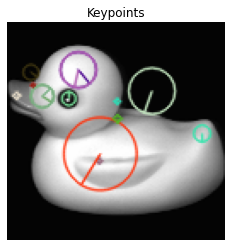

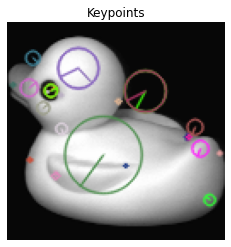

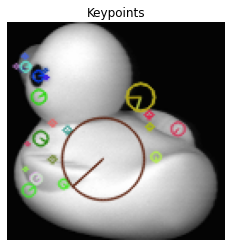

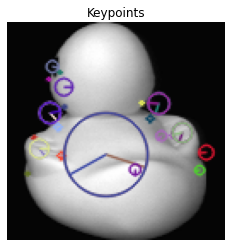

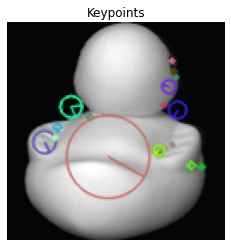

...

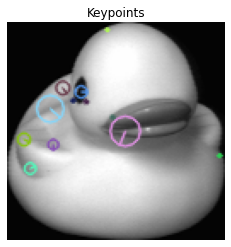

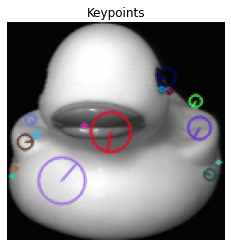

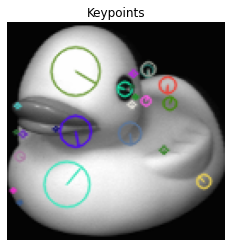

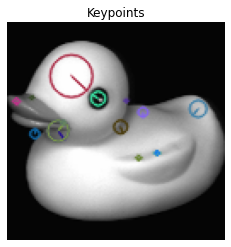

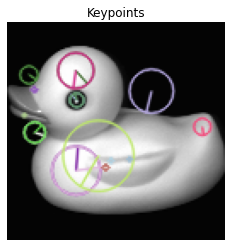

In [35]:
def draw_keypoints(img, keypoints):
    """Draw keypoints on the image for visualization."""
    img_with_kp = cv2.drawKeypoints(img, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    plt.imshow(cv2.cvtColor(img_with_kp, cv2.COLOR_BGR2RGB))
    plt.title('Keypoints')
    plt.axis('off')
    plt.show()

# Example usage
for i in range(len(images)):
    keypoints, _ = detect_and_compute(images[i], sift)
    draw_keypoints(images[i], keypoints)


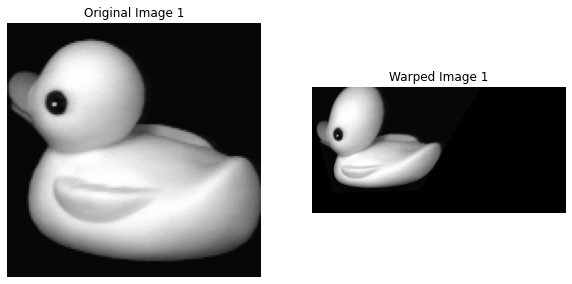

Not enough good matches found for image 2. Number of matches: 1. Skipping.
Not enough good matches found for image 3. Number of matches: 1. Skipping.
Not enough good matches found for image 4. Number of matches: 1. Skipping.
Not enough good matches found for image 5. Number of matches: 0. Skipping.
Not enough good matches found for image 6. Number of matches: 2. Skipping.


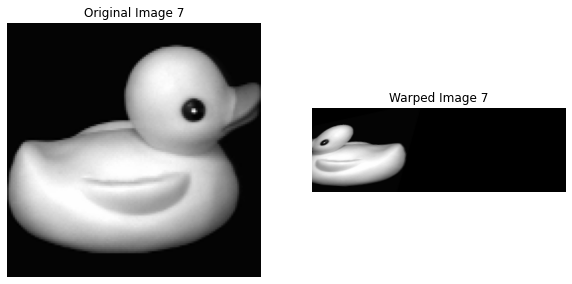

Not enough good matches found for image 8. Number of matches: 3. Skipping.


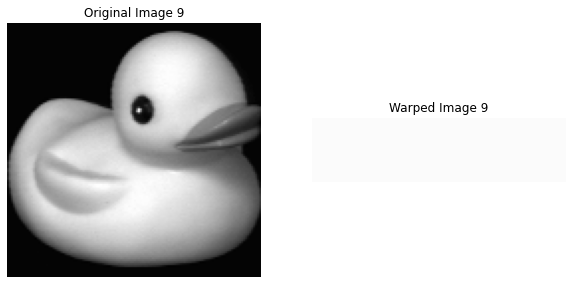

Not enough good matches found for image 10. Number of matches: 0. Skipping.
Not enough good matches found for image 11. Number of matches: 0. Skipping.
Not enough good matches found for image 12. Number of matches: 0. Skipping.
Not enough good matches found for image 13. Number of matches: 3. Skipping.


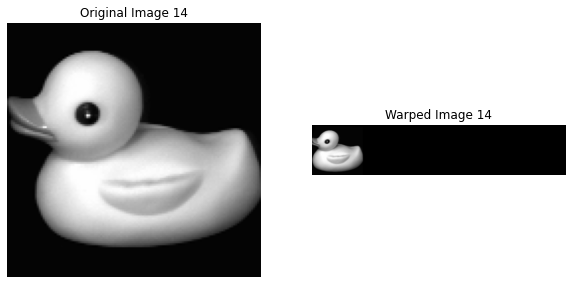

Saved panorama for object 1 to output_panorama\panorama_object_1.png.


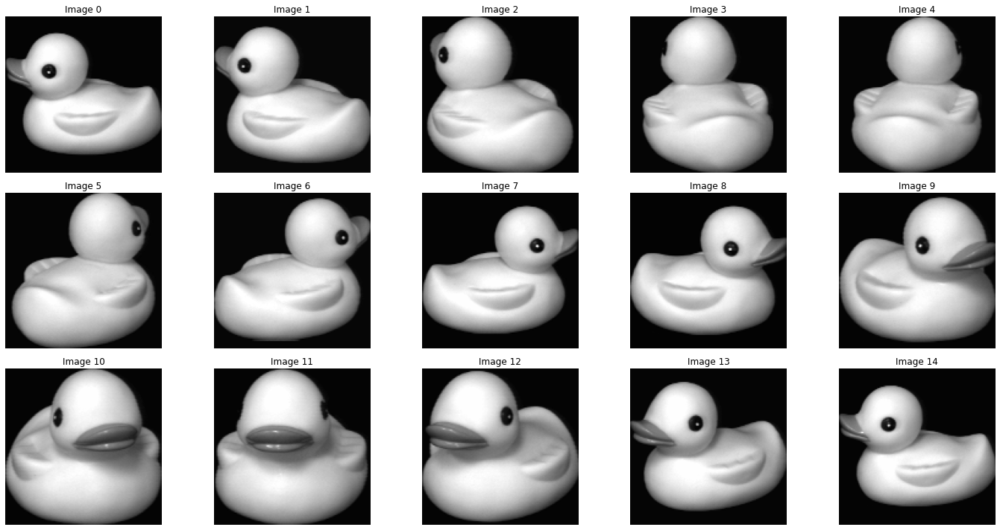

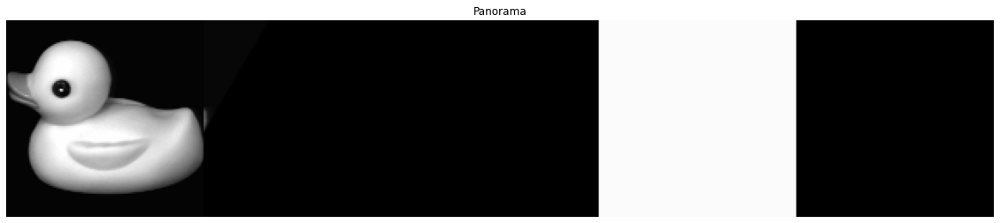

In [34]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def load_images(object_folder, image_list):
    """Load selected images for an object."""
    images = []
    for img_name in image_list:
        img_path = os.path.join(object_folder, img_name)
        img_path = os.path.normpath(img_path)
        if os.path.exists(img_path):
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            if img is not None:
                images.append(img)
    return images

def detect_and_compute(img, detector):
    kp, des = detector.detectAndCompute(img, None)
    return kp, des

def stitch_images(images, detector):
    """Stitch a list of images using SIFT and enhanced RANSAC."""
    if len(images) < 2:
        print("At least two images are required for stitching.")
        return None
    
    base_image = images[0]
    result = base_image
    
    for i in range(1, len(images)):
        keypoints1, descriptors1 = detect_and_compute(result, detector)
        keypoints2, descriptors2 = detect_and_compute(images[i], detector)
        
        if descriptors1 is None or descriptors2 is None:
            print(f"No descriptors found for image {i}. Skipping.")
            continue
        
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)
        
        # Apply ratio test
        good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]
        
        if len(good_matches) < 4:
            print(f"Not enough good matches found for image {i}. Number of matches: {len(good_matches)}. Skipping.")
            continue
        
        src_pts = np.float32([keypoints1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        
        # Enhance RANSAC parameters
        M, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, ransacReprojThreshold=5.0, maxIters=2000)
        
        if M is None:
            print(f"Homography computation failed for image {i}. Skipping.")
            continue
        
        # Check the type and shape of the homography matrix
        if not (M.dtype == np.float32 or M.dtype == np.float64) or M.shape != (3, 3):
            print(f"Invalid homography matrix for image {i}.")
            continue
        
        h, w = result.shape[:2]
        warped_image = cv2.warpPerspective(images[i], M, (w + images[i].shape[1], h))
        
        # Check if warped_image contains valid content
        if np.sum(warped_image) == 0:
            print(f"Warped image {i} is completely black. Skipping.")
            continue
        
        # Check if warped_image is completely white
        if np.all(warped_image == 255):
            print(f"Warped image {i} is completely white. Skipping.")
            continue
        
        # Debugging: Display warped image
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
        plt.title(f'Original Image {i}')
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB))
        plt.title(f'Warped Image {i}')
        plt.axis('off')
        plt.show()
        
        result = np.hstack((result, warped_image[:, w:]))
    
    return result


# Initialize SIFT with adjusted parameters
sift = cv2.SIFT_create(
    nfeatures=5000,  # Maximum number of features to retain
    nOctaveLayers=3, # Number of layers in each octave
    contrastThreshold=0.04, # Threshold to filter out weak features
    edgeThreshold=10  # Threshold to filter out edge-like features
)
# Example process
dataset_path = r'C:\Users\www\Downloads\archive\coil-20'
output_dir = 'output_panorama'
os.makedirs(output_dir, exist_ok=True)

obj_num = 1
object_folder = os.path.join(dataset_path, str(obj_num))
image_list = [f'obj{obj_num}__{i}.png' for i in range(0, 72, 5)]

images = load_images(object_folder, image_list)
panorama = stitch_images(images, sift)

if panorama is not None:
    output_path = os.path.join(output_dir, f'panorama_object_{obj_num}.png')
    cv2.imwrite(output_path, panorama)
    print(f"Saved panorama for object {obj_num} to {output_path}.")

    # Display original images
    plt.figure(figsize=(20, 10))
    for i, img in enumerate(images):
        plt.subplot(3, 5, i + 1)  # Adjust rows and columns based on number of images
        plt.imshow(img, cmap='gray')
        plt.title(f'Image {i}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Display panorama
    plt.figure(figsize=(20, 10))
    plt.imshow(panorama, cmap='gray')
    plt.title('Panorama')
    plt.axis('off')
    plt.show()

else:
    print(f"Failed to create panorama for object {obj_num}.")


Saved circular panorama for object 1 to output_circular_panorama\circular_panorama_object_1.png.


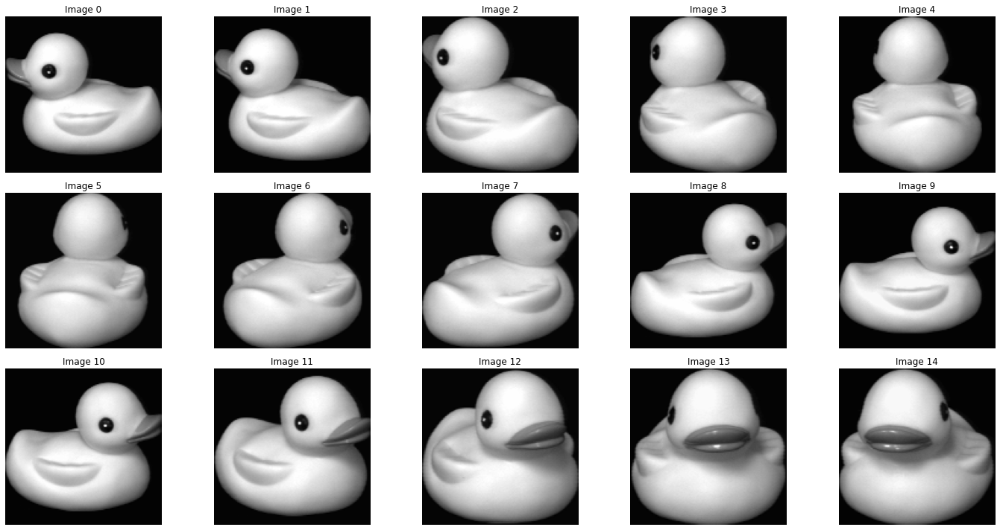

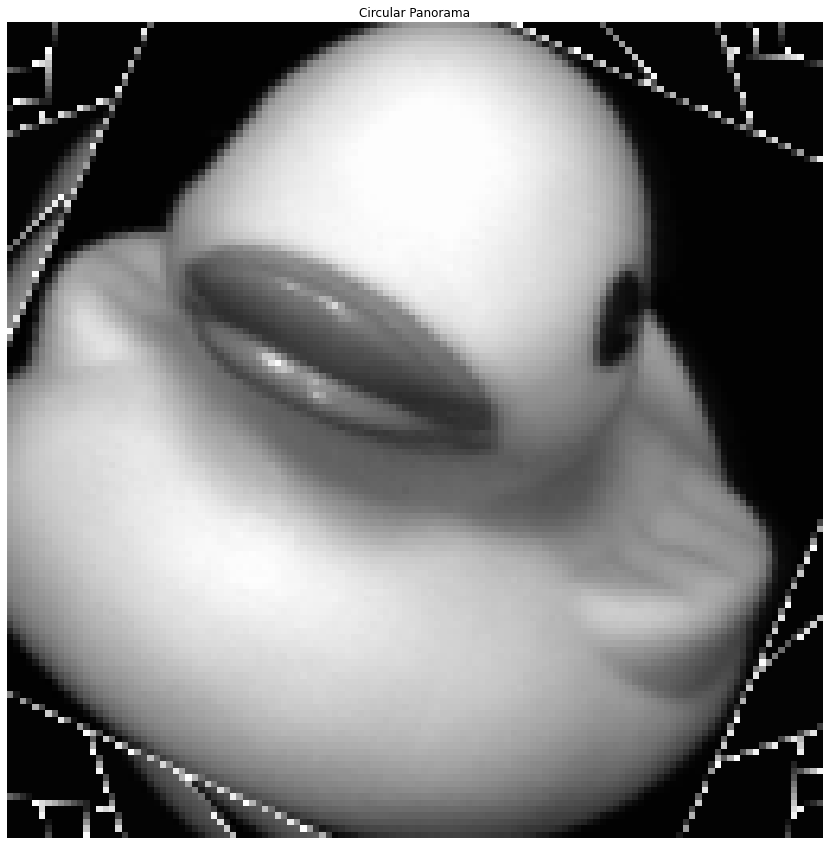

Saved circular panorama for object 2 to output_circular_panorama\circular_panorama_object_2.png.


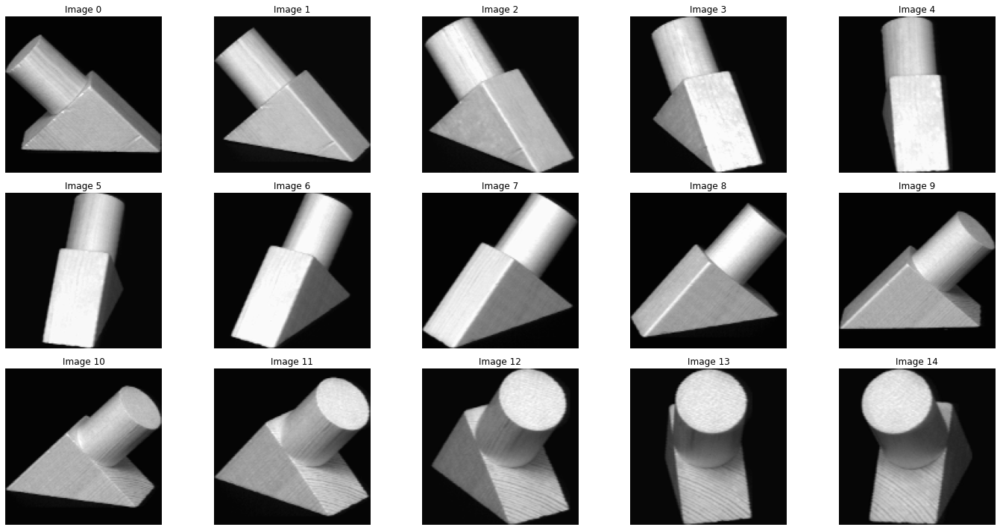

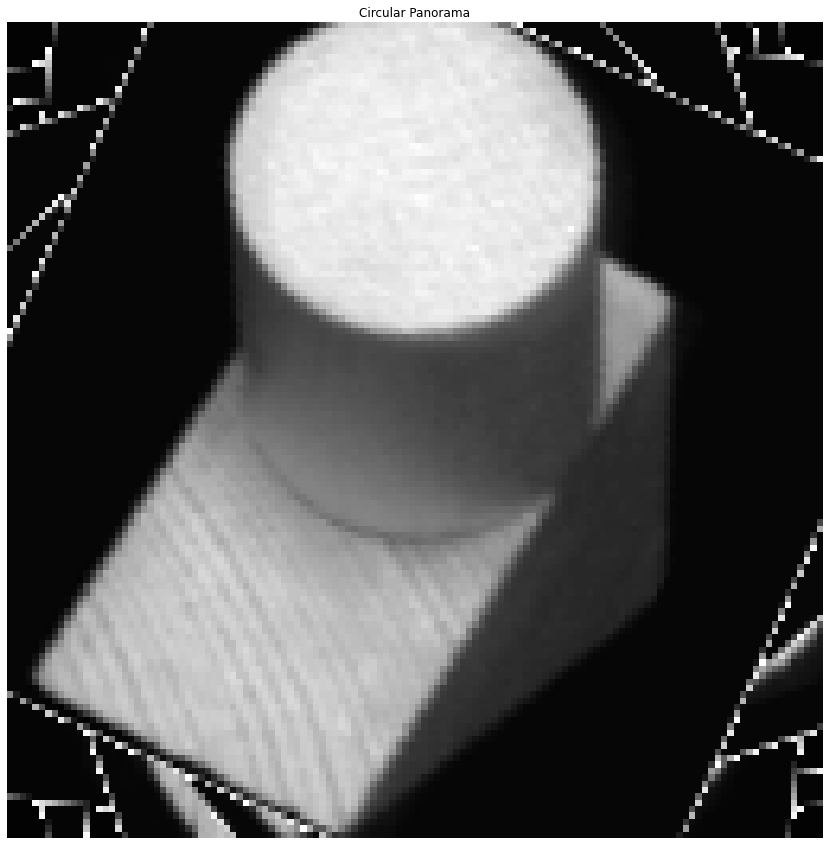

Saved circular panorama for object 3 to output_circular_panorama\circular_panorama_object_3.png.


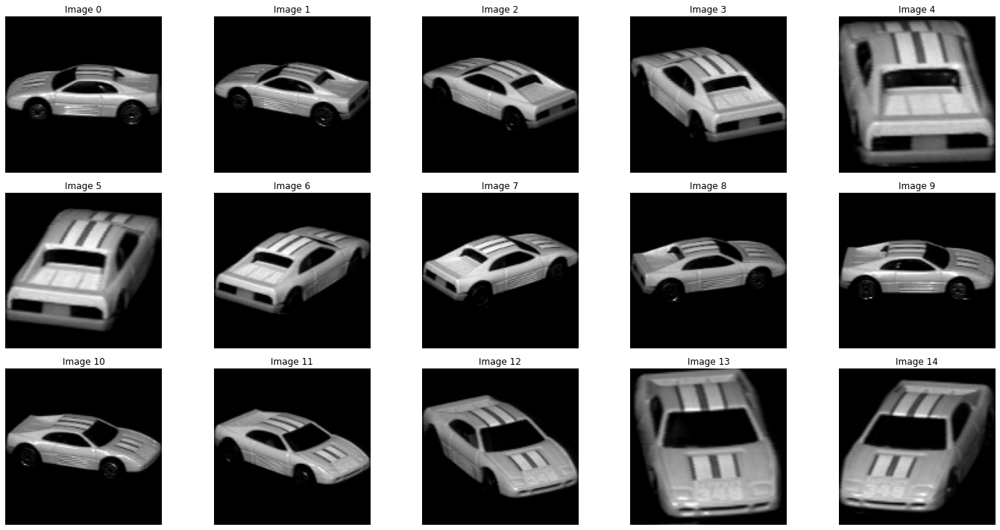

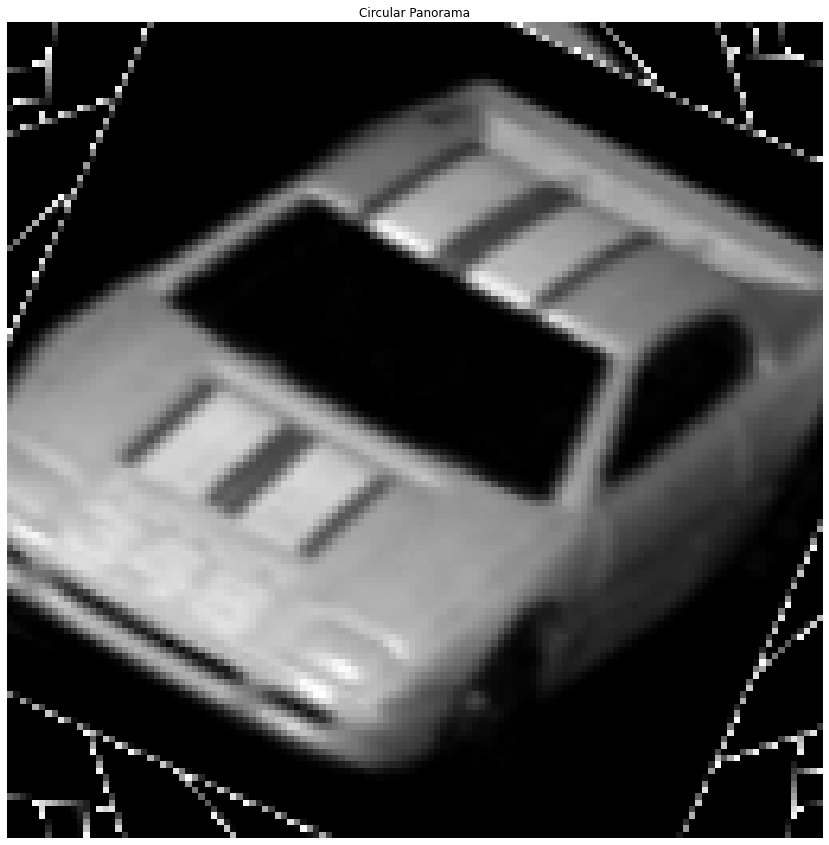

Saved circular panorama for object 4 to output_circular_panorama\circular_panorama_object_4.png.


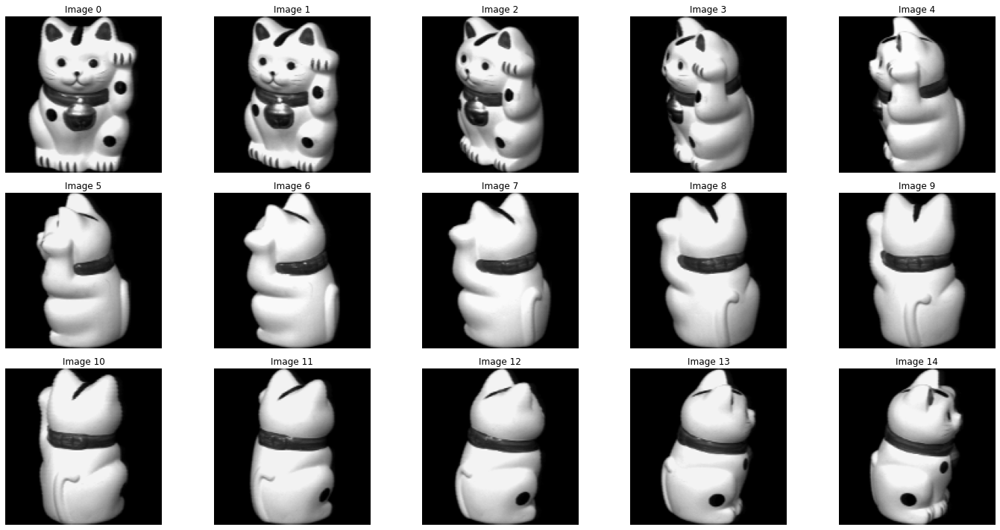

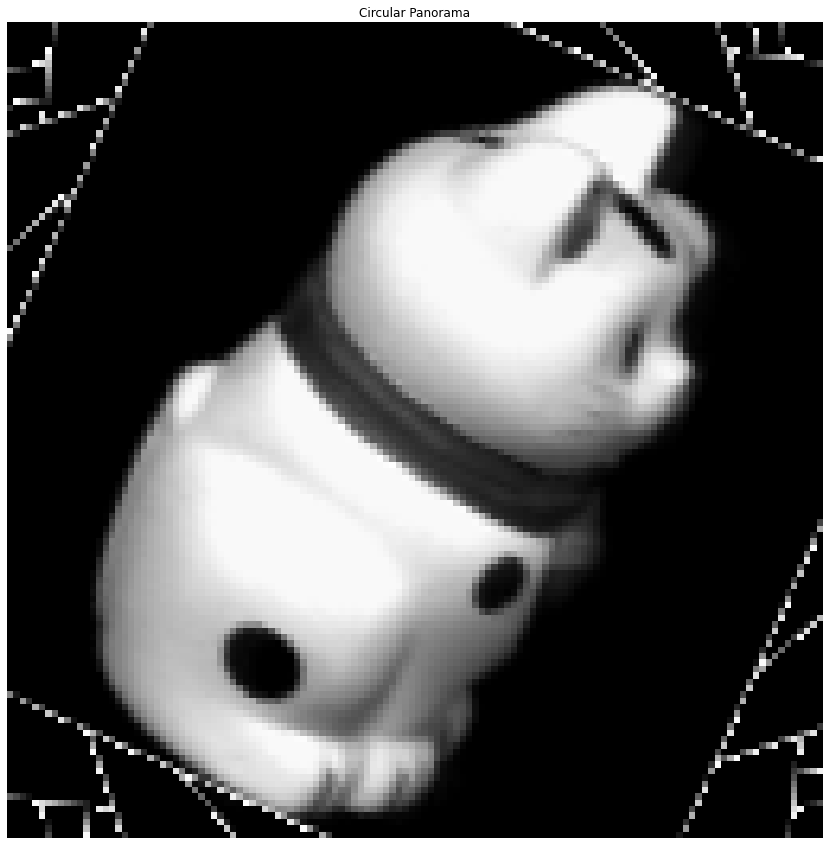

Saved circular panorama for object 5 to output_circular_panorama\circular_panorama_object_5.png.


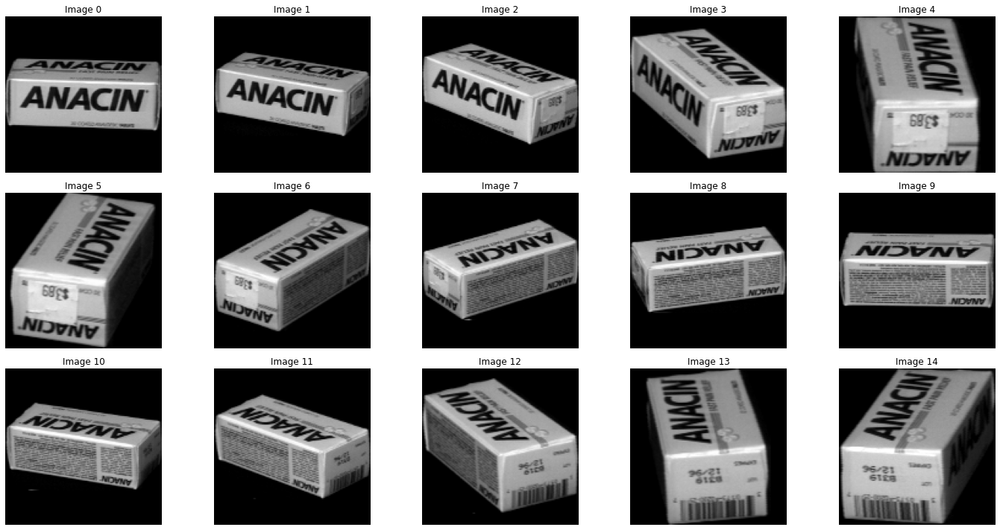

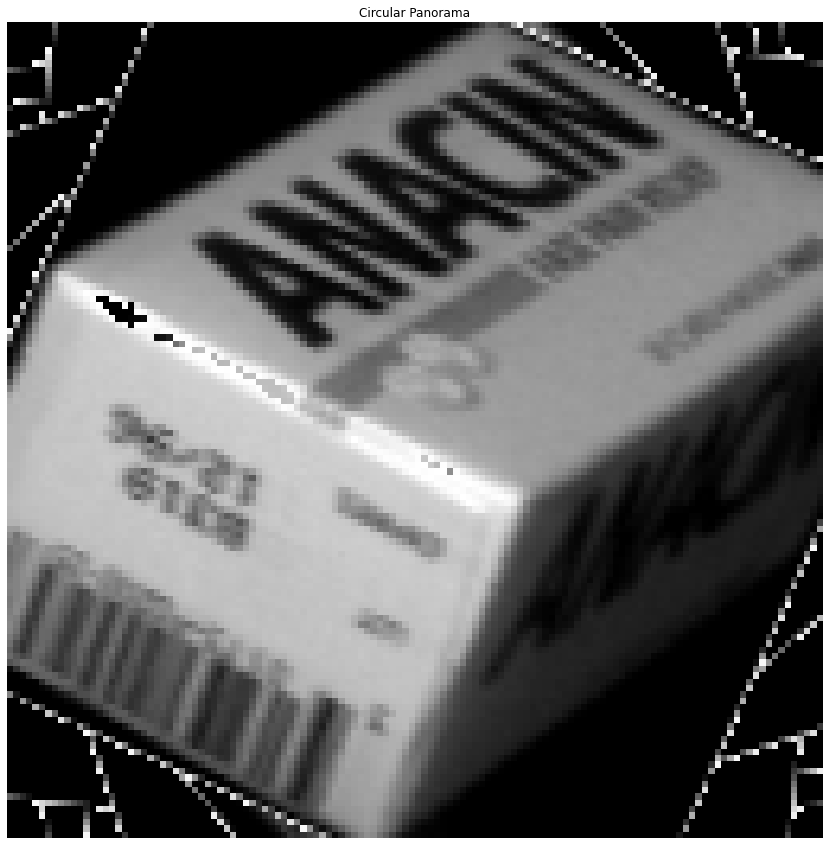

Saved circular panorama for object 6 to output_circular_panorama\circular_panorama_object_6.png.


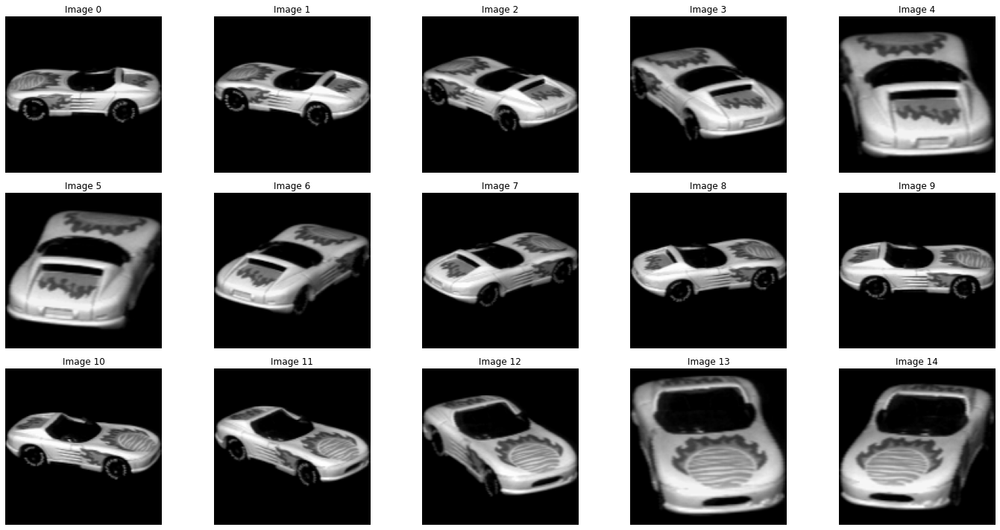

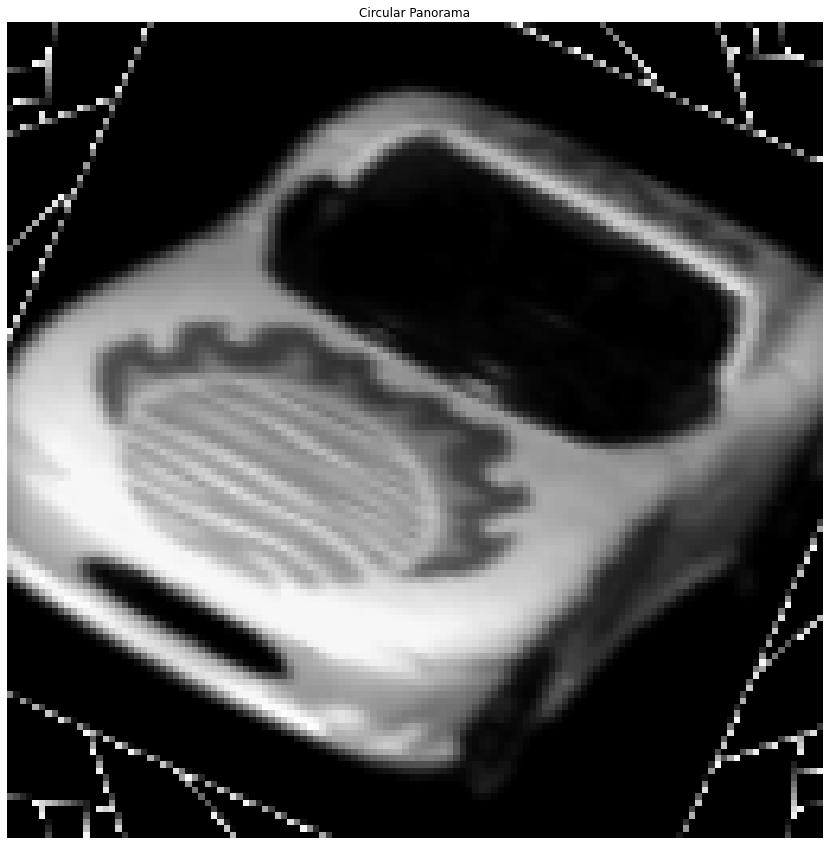

Saved circular panorama for object 7 to output_circular_panorama\circular_panorama_object_7.png.


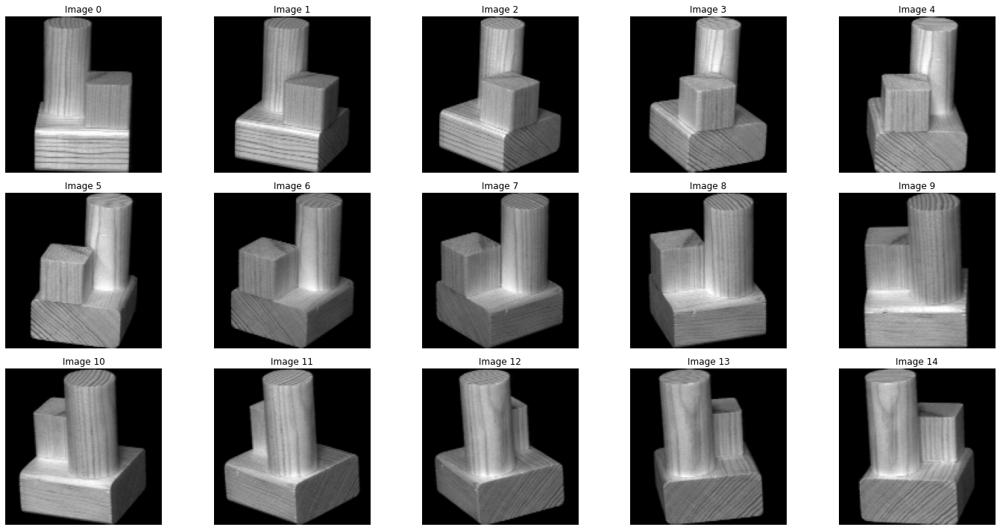

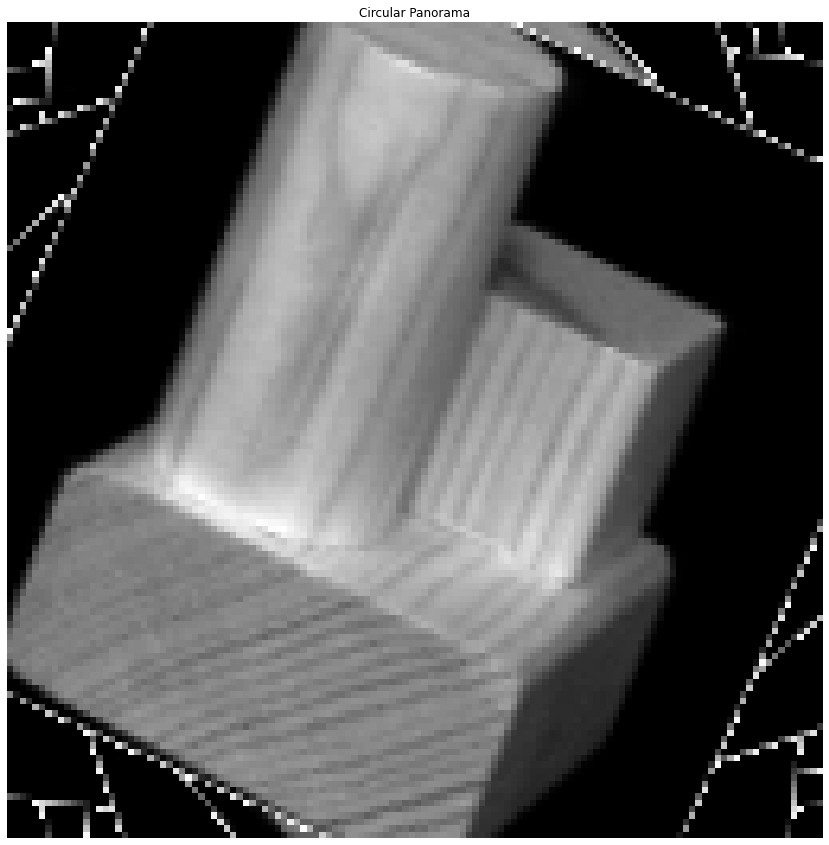

Saved circular panorama for object 8 to output_circular_panorama\circular_panorama_object_8.png.


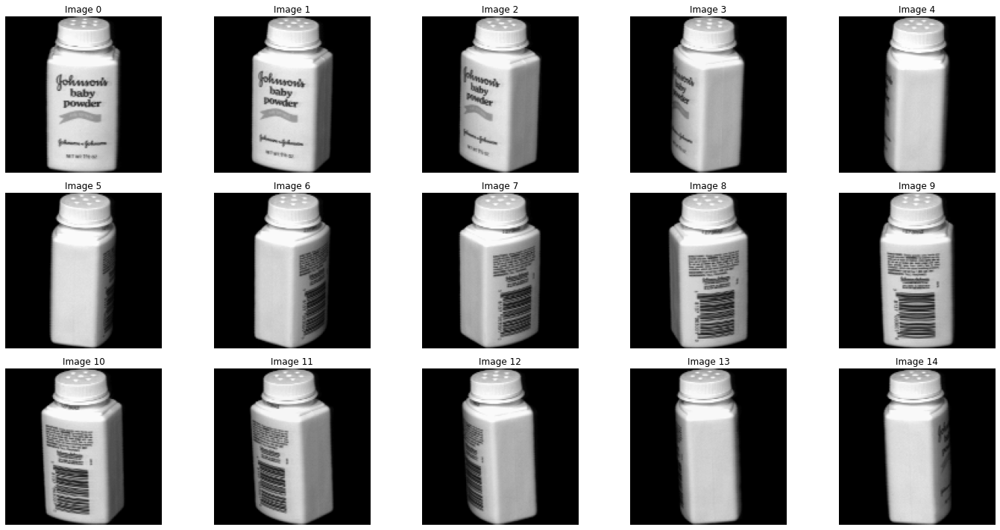

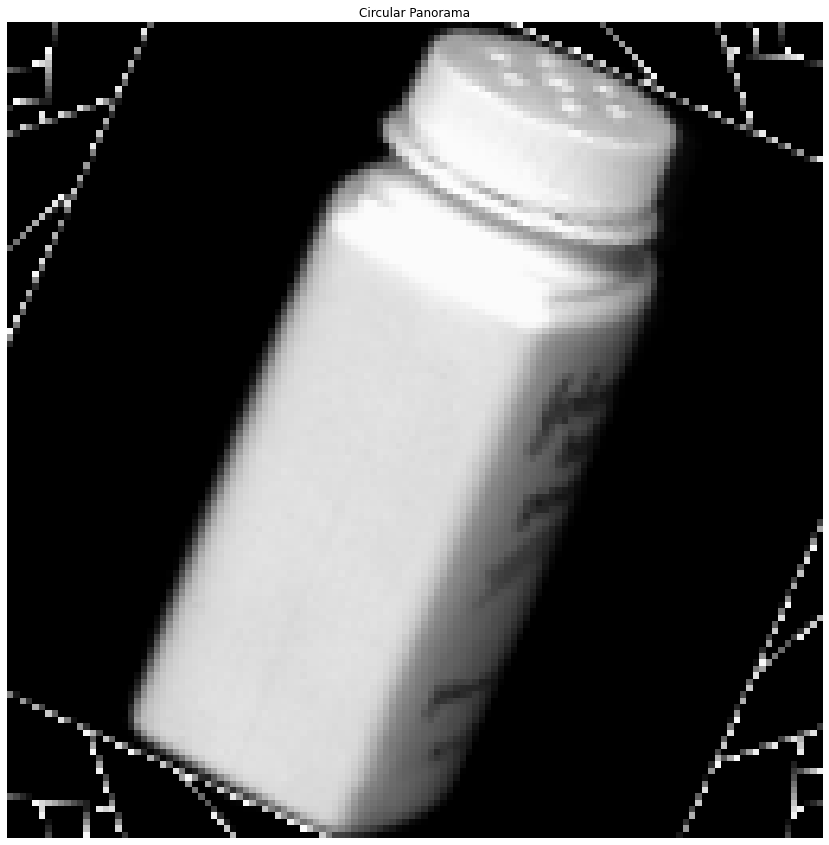

Saved circular panorama for object 9 to output_circular_panorama\circular_panorama_object_9.png.


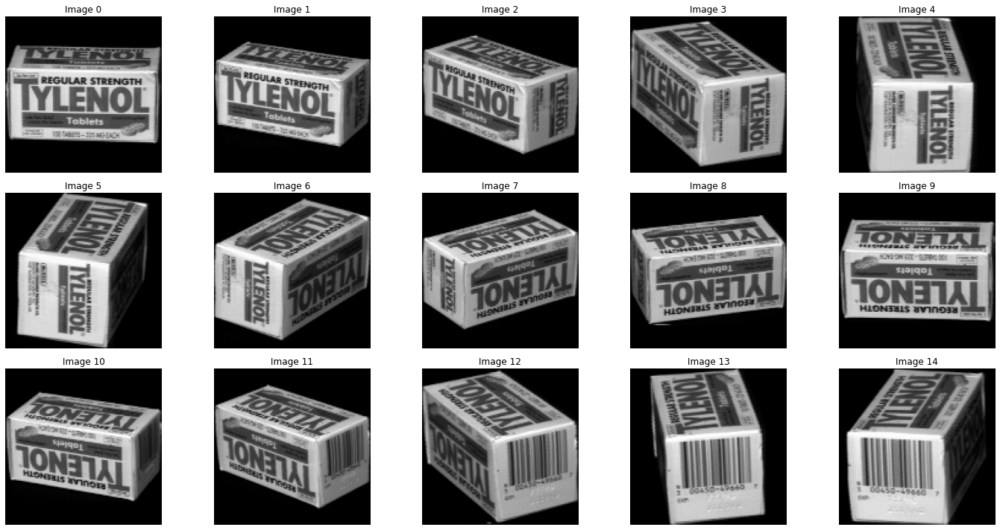

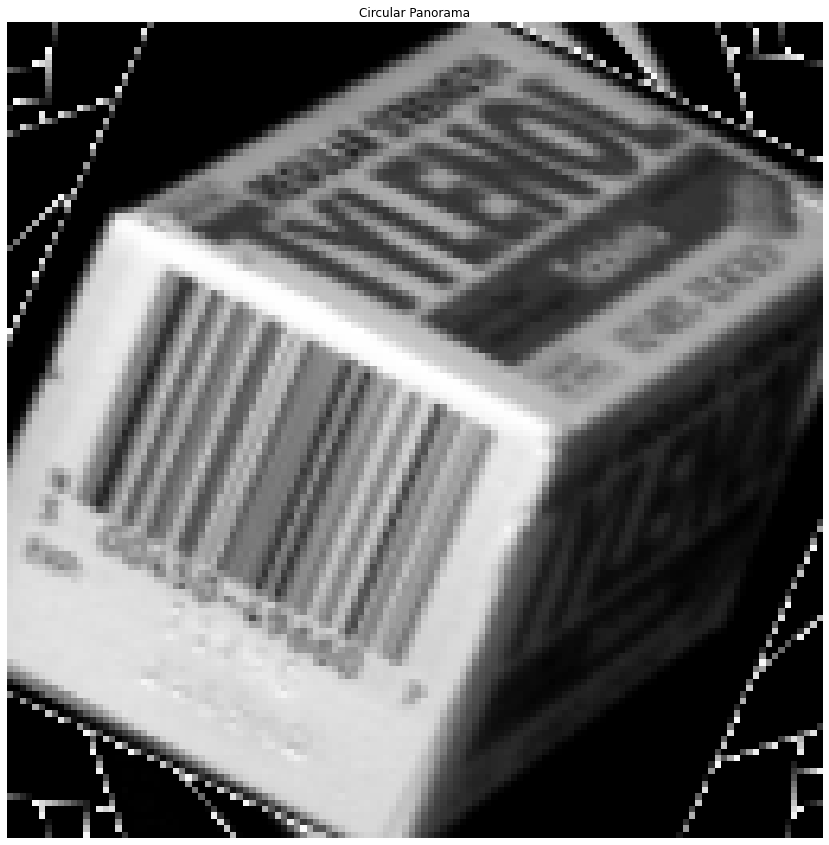

Saved circular panorama for object 10 to output_circular_panorama\circular_panorama_object_10.png.


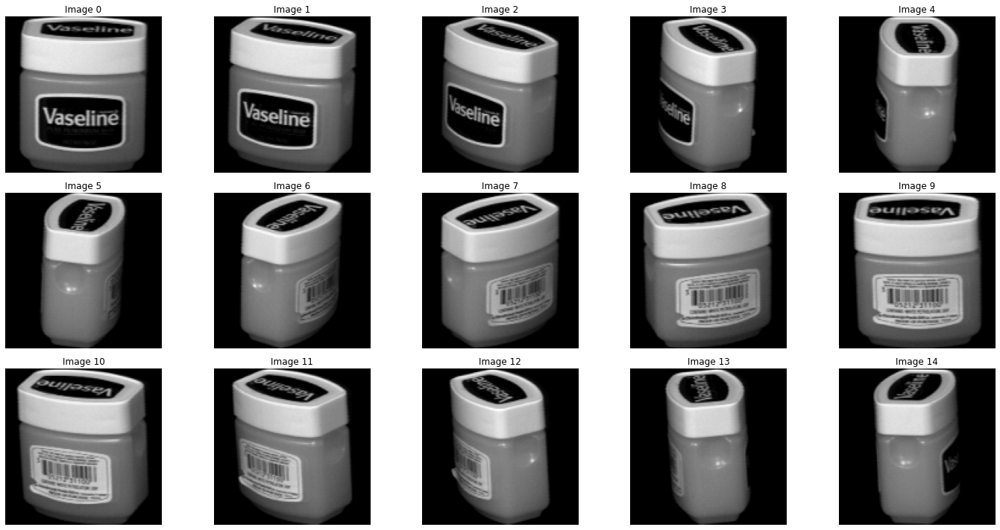

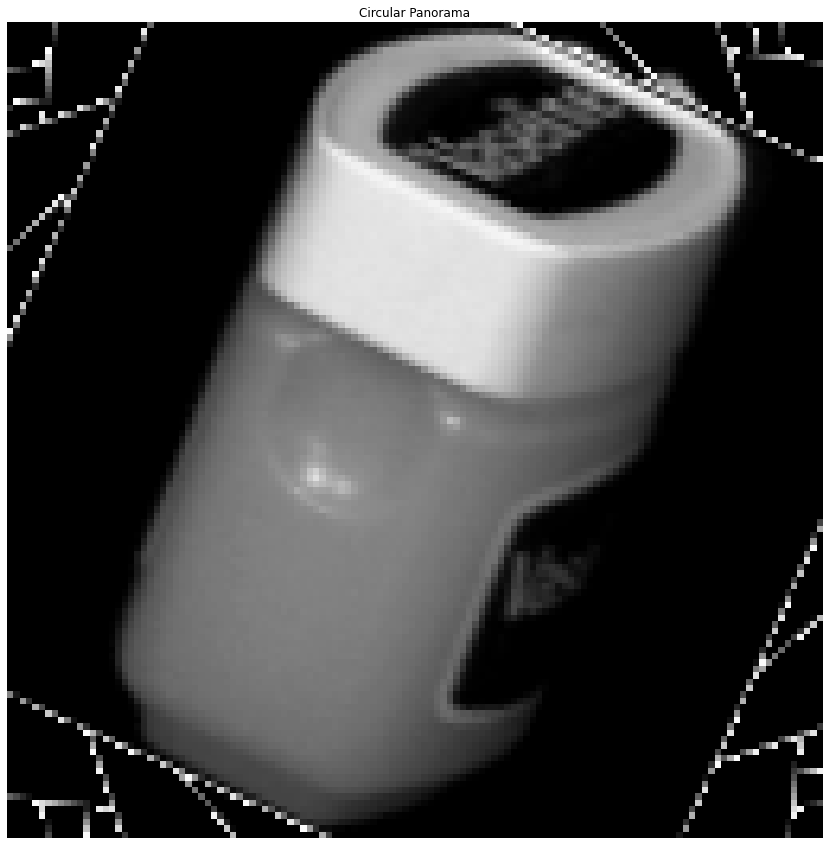

Saved circular panorama for object 11 to output_circular_panorama\circular_panorama_object_11.png.


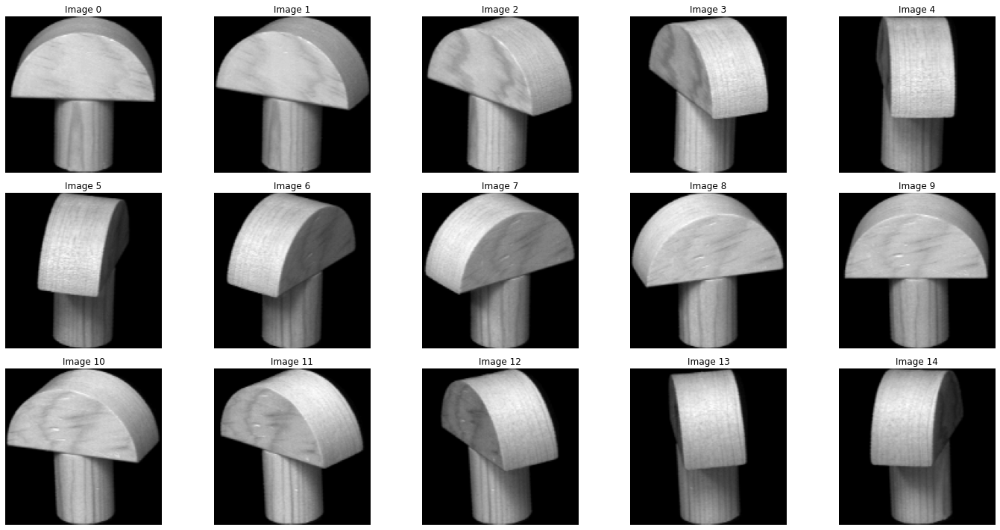

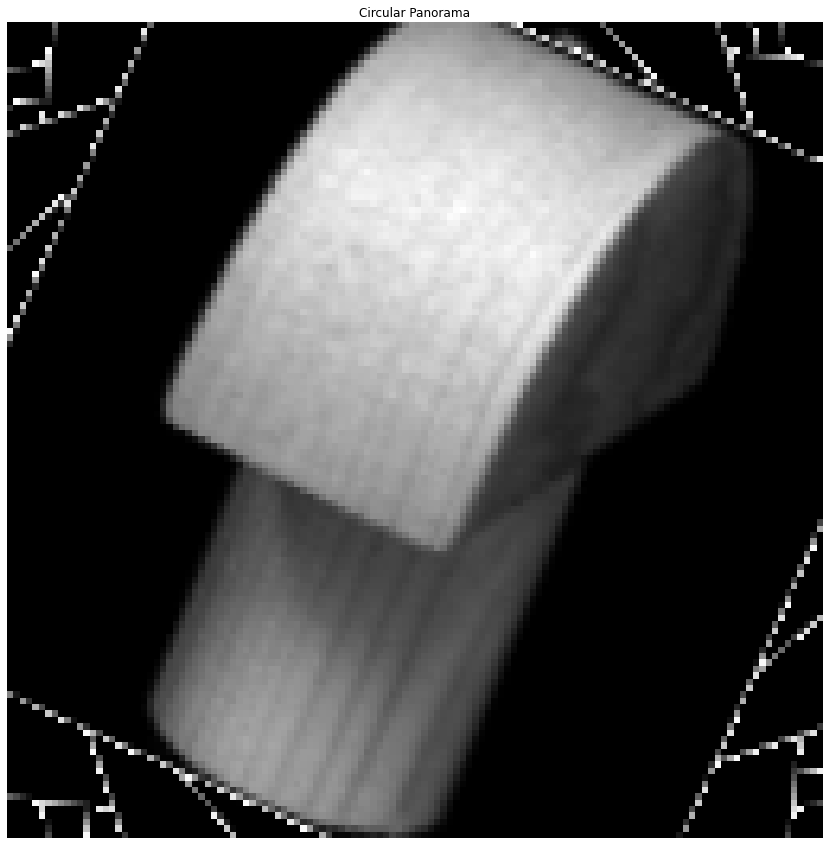

Saved circular panorama for object 12 to output_circular_panorama\circular_panorama_object_12.png.


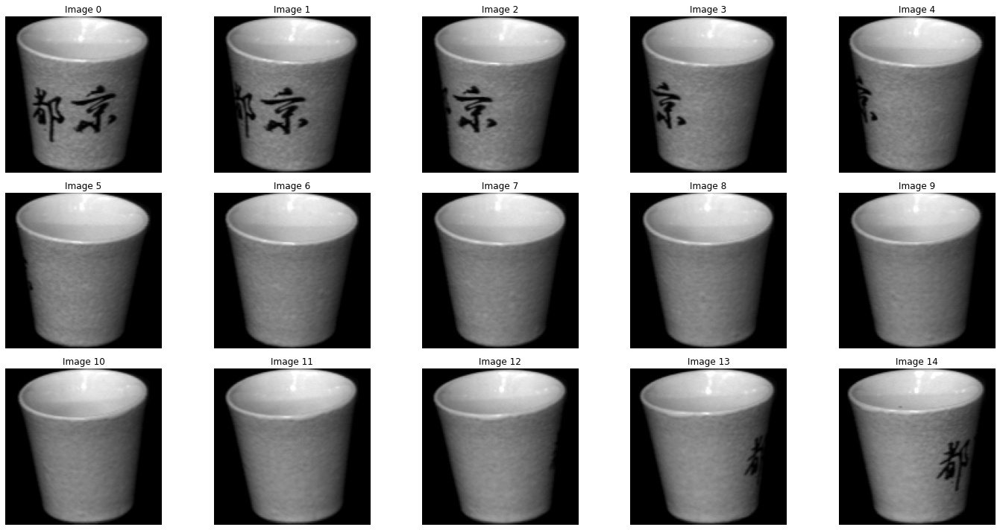

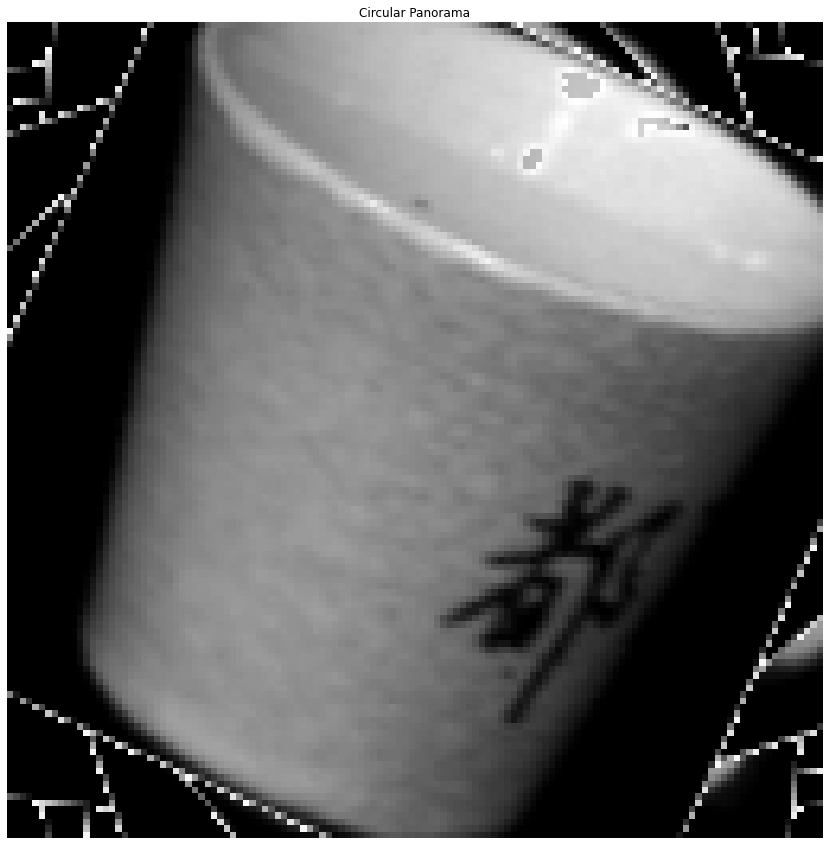

Saved circular panorama for object 13 to output_circular_panorama\circular_panorama_object_13.png.


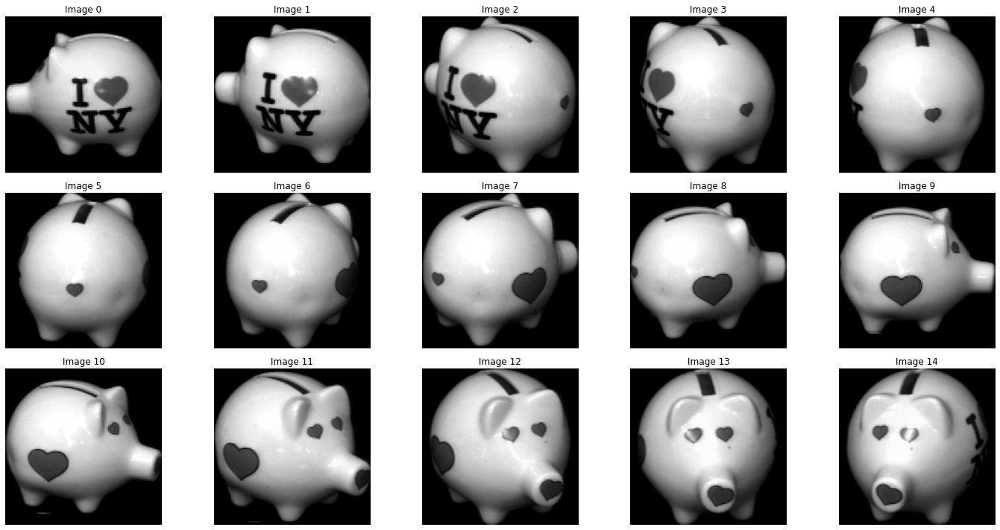

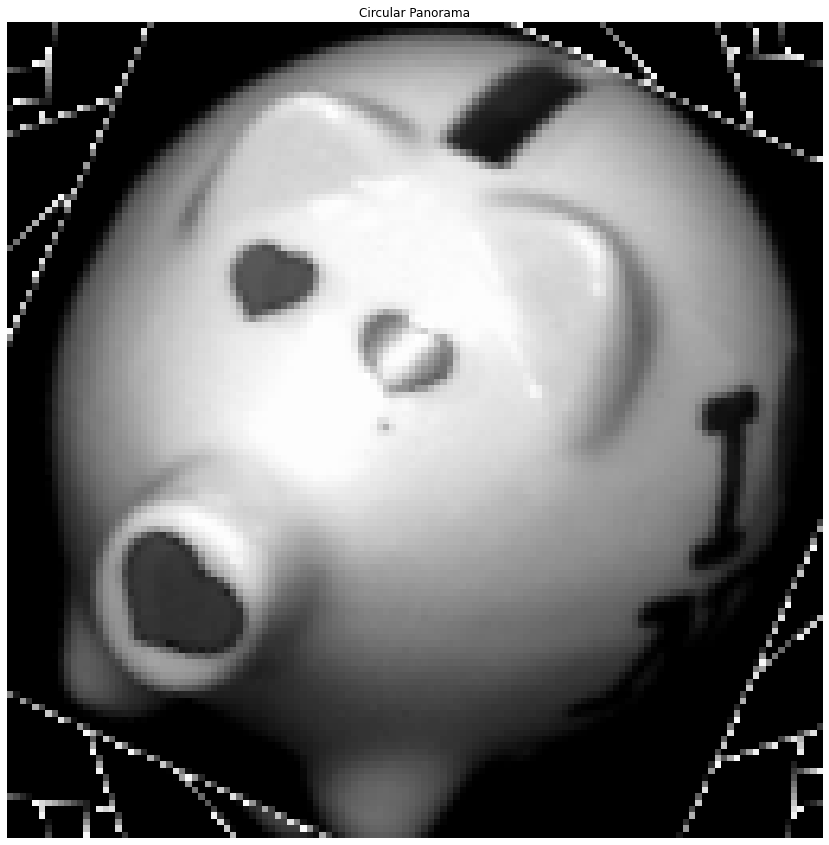

Saved circular panorama for object 14 to output_circular_panorama\circular_panorama_object_14.png.


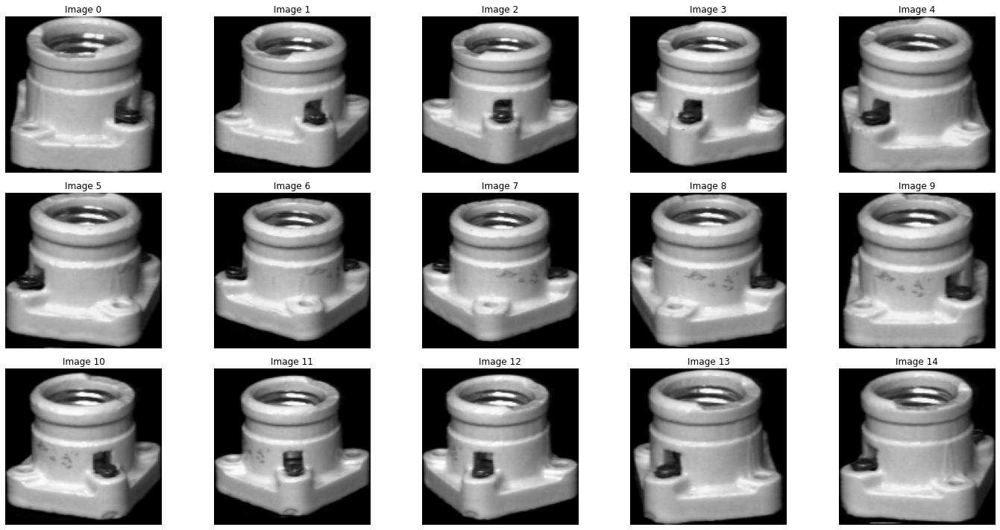

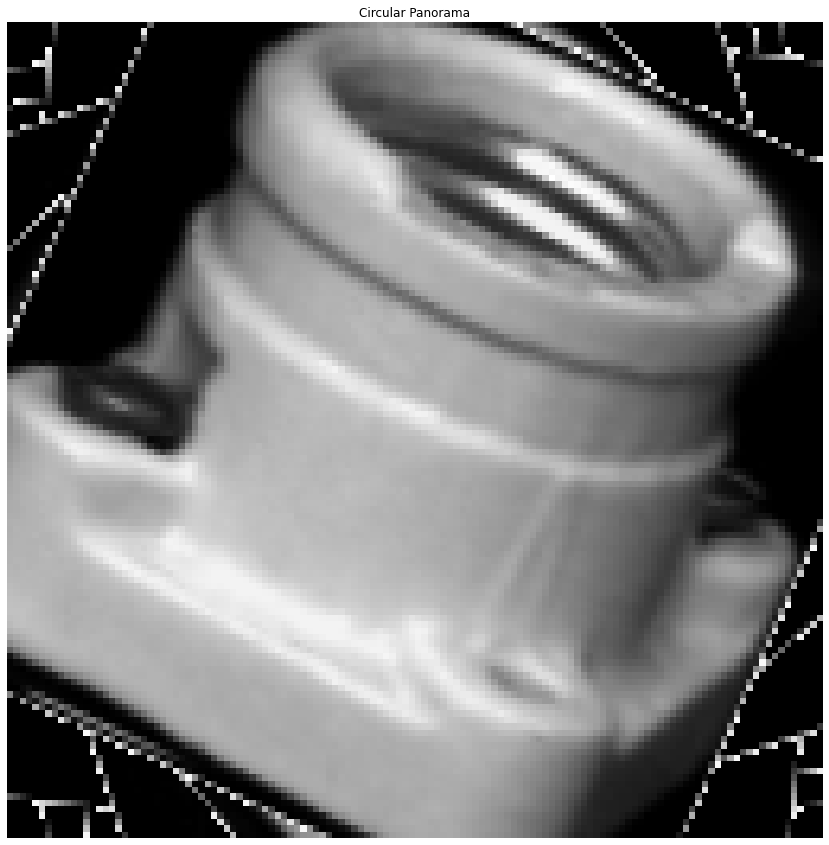

Saved circular panorama for object 15 to output_circular_panorama\circular_panorama_object_15.png.


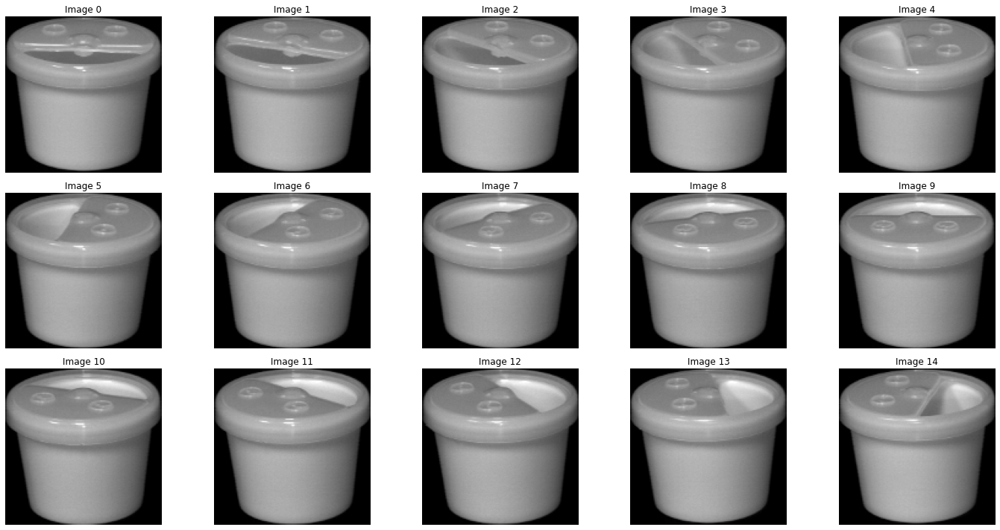

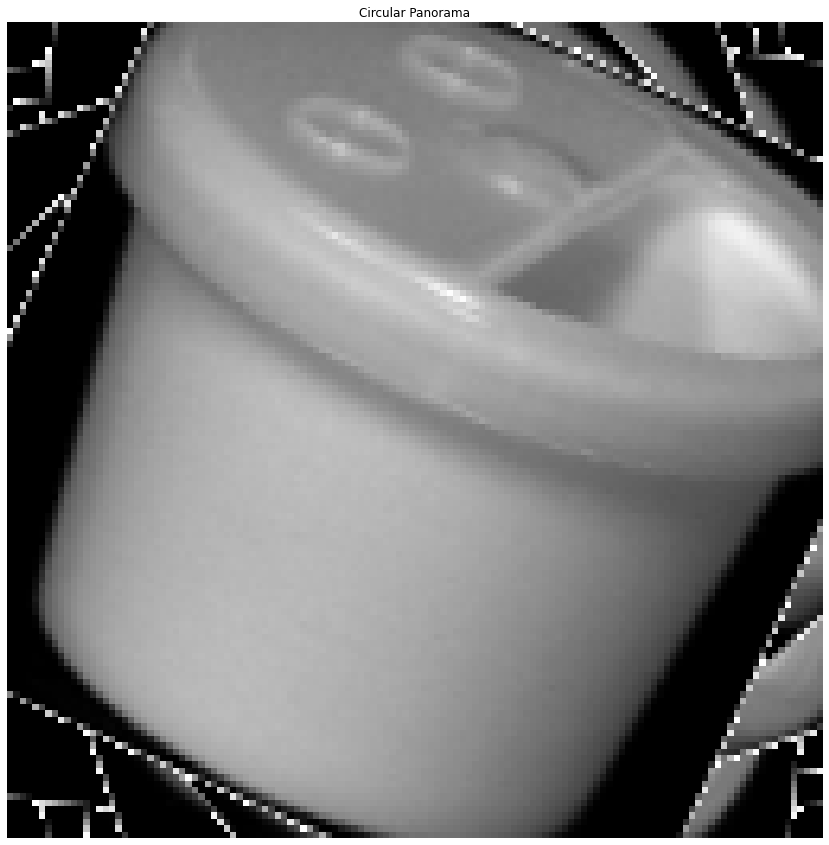

Saved circular panorama for object 16 to output_circular_panorama\circular_panorama_object_16.png.


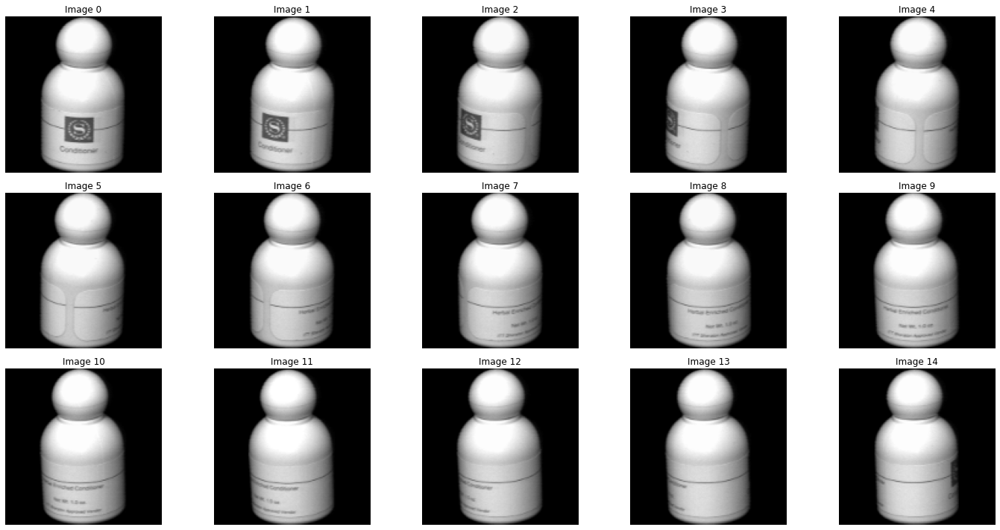

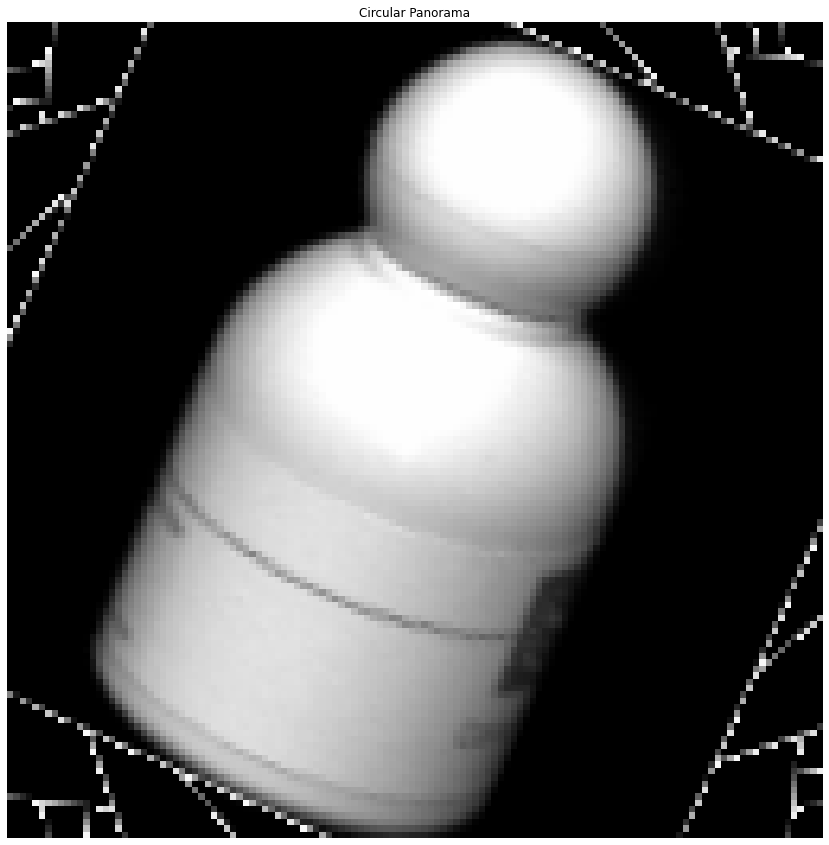

Saved circular panorama for object 17 to output_circular_panorama\circular_panorama_object_17.png.


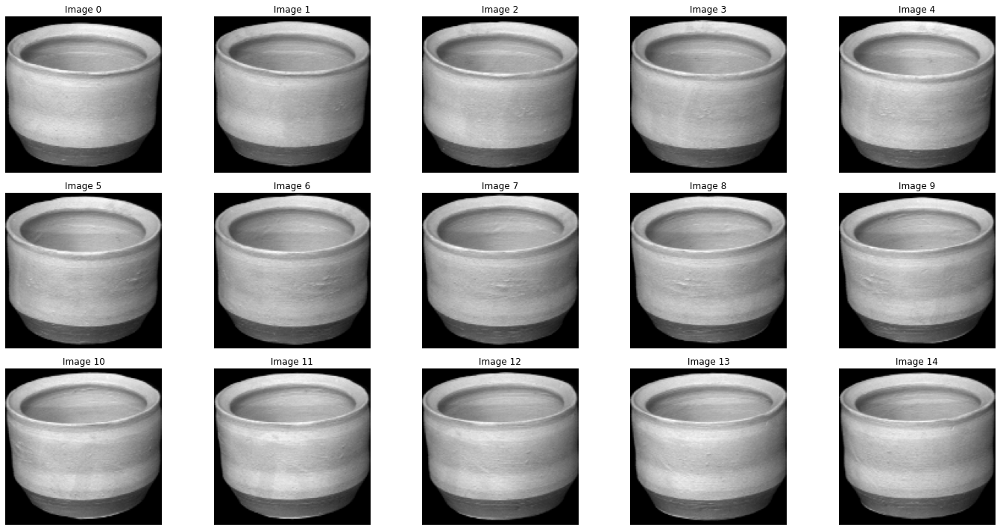

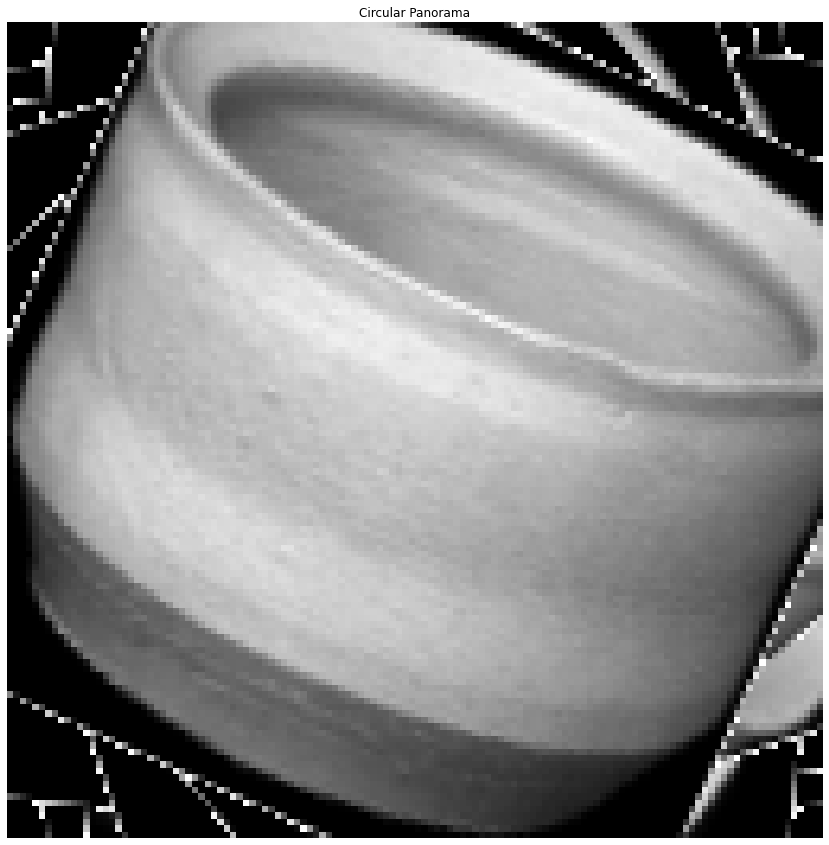

Saved circular panorama for object 18 to output_circular_panorama\circular_panorama_object_18.png.


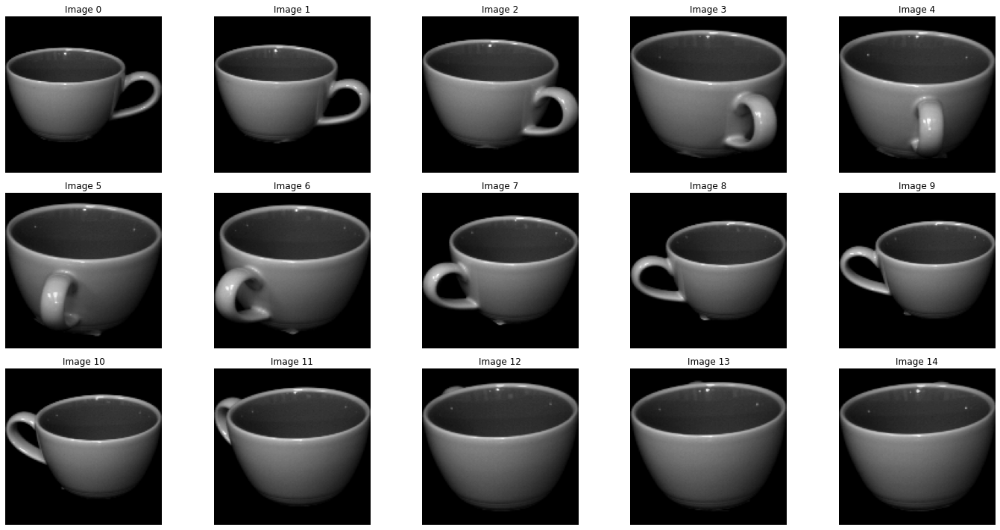

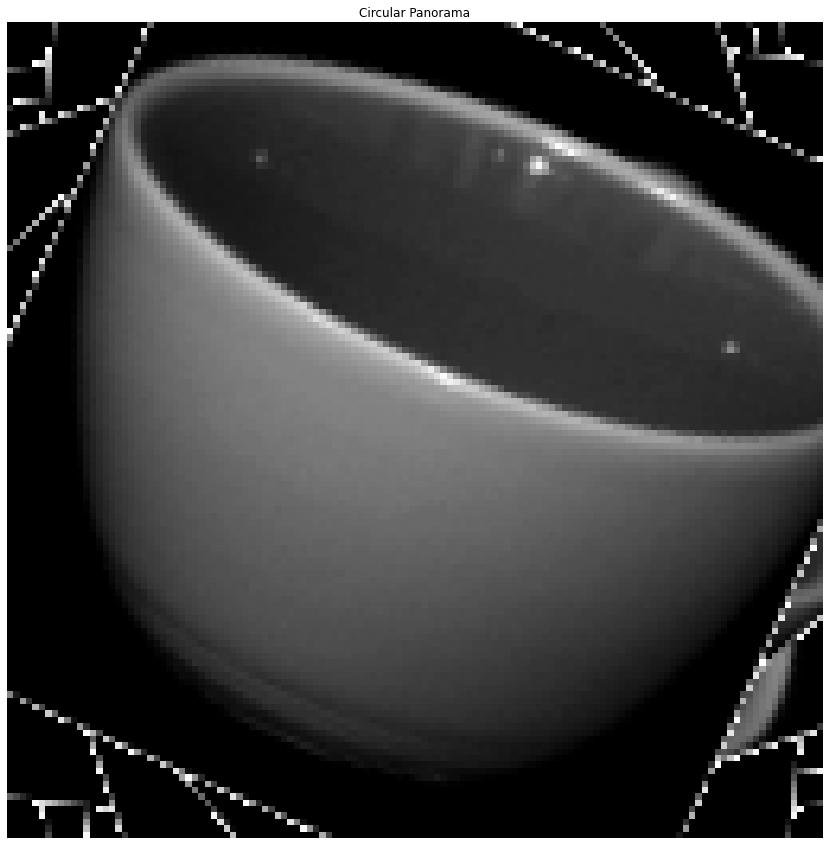

Saved circular panorama for object 19 to output_circular_panorama\circular_panorama_object_19.png.


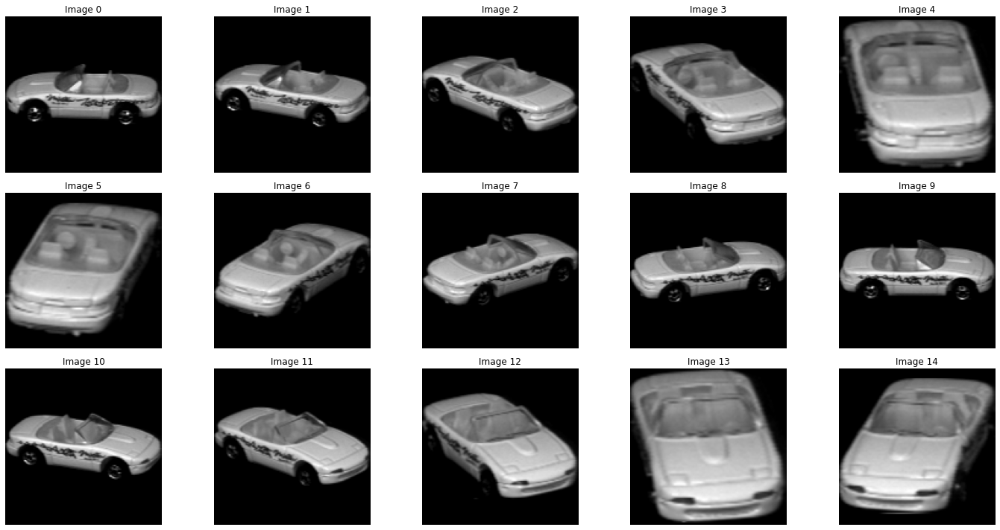

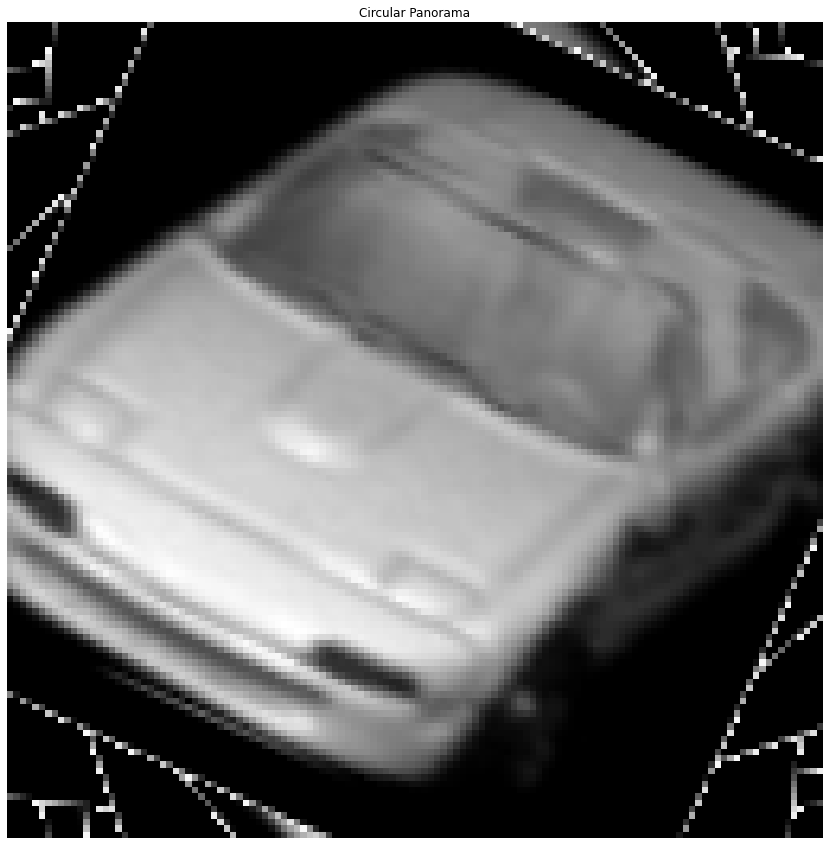

Saved circular panorama for object 20 to output_circular_panorama\circular_panorama_object_20.png.


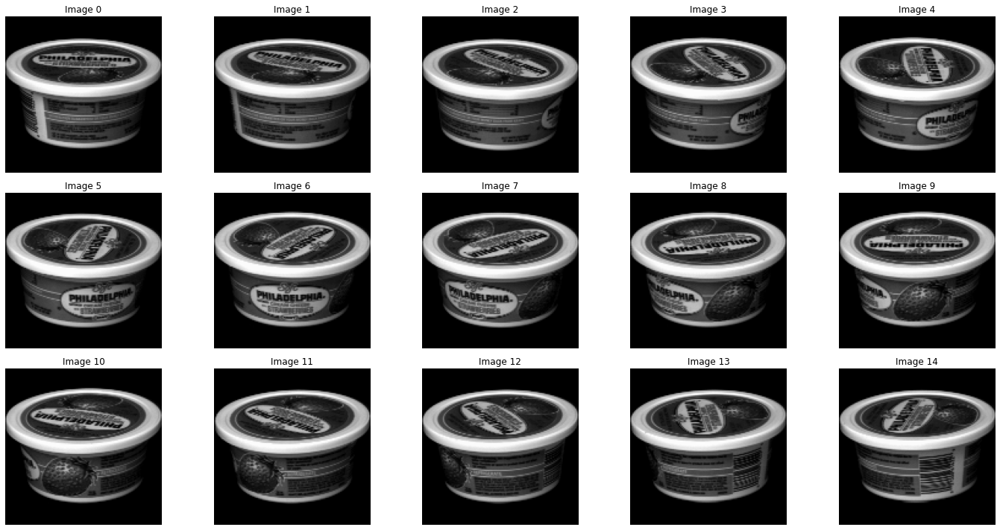

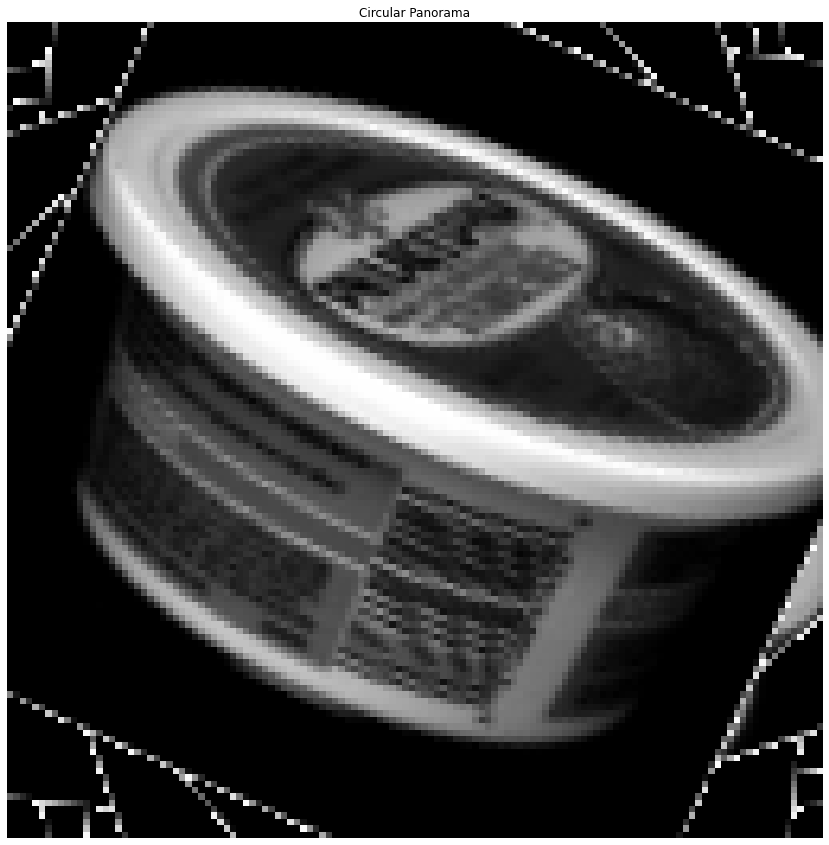

In [52]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def load_images(object_folder, image_list):
    """Load selected images for an object."""
    images = []
    for img_name in image_list:
        img_path = os.path.join(object_folder, img_name)
        img_path = os.path.normpath(img_path)
        if os.path.exists(img_path):
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            if img is not None:
                images.append(img)
    return images

def create_circular_panorama(images):
    """Create a circular panorama from a list of images."""
    if len(images) < 2:
        print("At least two images are required for stitching.")
        return None
    
    # Initialize panorama canvas
    height, width = images[0].shape
    radius = width // 2
    panorama_height = 2 * radius
    panorama_width = 2 * radius
    panorama = np.ones((panorama_height, panorama_width), dtype=np.uint8) * 255

    center = (panorama_width // 2, panorama_height // 2)
    num_images = len(images)
    angle_step = 360 / num_images

    for i, img in enumerate(images):
        angle = i * angle_step
        angle_rad = np.deg2rad(angle)
        
        # Compute rotation matrix
        rot_matrix = cv2.getRotationMatrix2D(center, angle, 1)
        
        # Warp image to circular position
        warped_image = cv2.warpAffine(img, rot_matrix, (panorama_width, panorama_height), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=(255, 255, 255))
        
        # Blend images
        mask = (warped_image < 255).astype(np.uint8)
        panorama = np.where(mask == 1, warped_image, panorama)
    
    return panorama

def display_images(images):
    num_images = len(images)
    cols = 5  # Number of columns for the subplot
    rows = (num_images + cols - 1) // cols  # Calculate the number of rows needed

    plt.figure(figsize=(20, 10))
    for i, img in enumerate(images):
        plt.subplot(rows, cols, i + 1)  # Adjust rows and columns based on number of images
        plt.imshow(img, cmap='gray')
        plt.title(f'Image {i}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

def display_panorama(panorama):
    plt.figure(figsize=(15, 15))  # Adjusted size for better visibility in Jupyter Notebook
    plt.imshow(panorama, cmap='gray')
    plt.title('Circular Panorama')
    plt.axis('off')
    plt.show()

# Directory paths and parameters
dataset_path = r'C:\Users\www\Downloads\archive\coil-20'
output_dir = 'output_circular_panorama'
os.makedirs(output_dir, exist_ok=True)

# Process each object
for obj_num in range(1, 21):  # Assuming there are 20 objects (1 to 20)
    object_folder = os.path.join(dataset_path, str(obj_num))
    image_list = [f'obj{obj_num}__{i}.png' for i in range(0, 72, 4)]

    # Ensure only 15 images are selected
    image_list = image_list[:15]

    images = load_images(object_folder, image_list)
    circular_panorama = create_circular_panorama(images)

    if circular_panorama is not None:
        output_path = os.path.join(output_dir, f'circular_panorama_object_{obj_num}.png')
        cv2.imwrite(output_path, circular_panorama)
        print(f"Saved circular panorama for object {obj_num} to {output_path}.")

        # Display images
        display_images(images)

        # Display circular panorama
        display_panorama(circular_panorama)

    else:
        print(f"Failed to create circular panorama for object {obj_num}.")


Saved spherical panorama for object 1 to output_spherical_panorama\spherical_panorama_object_1.png.


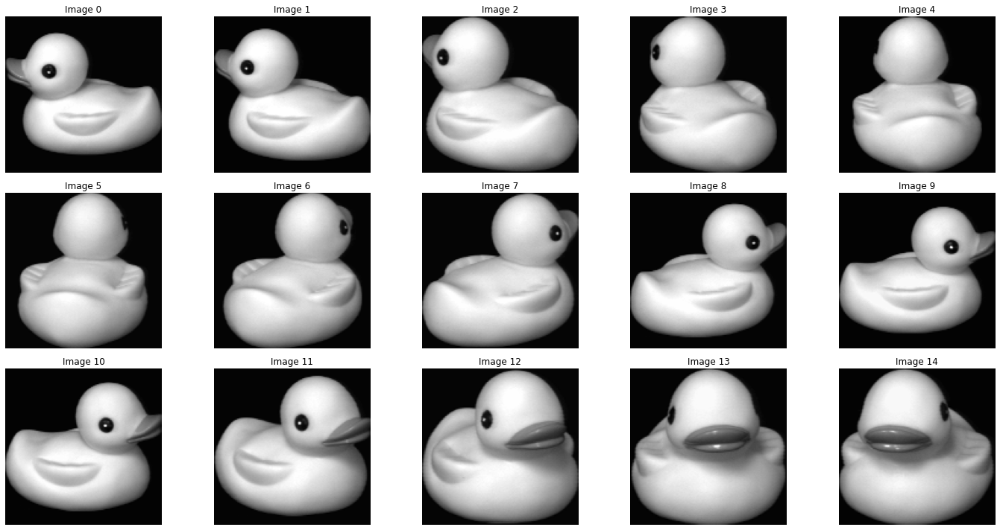

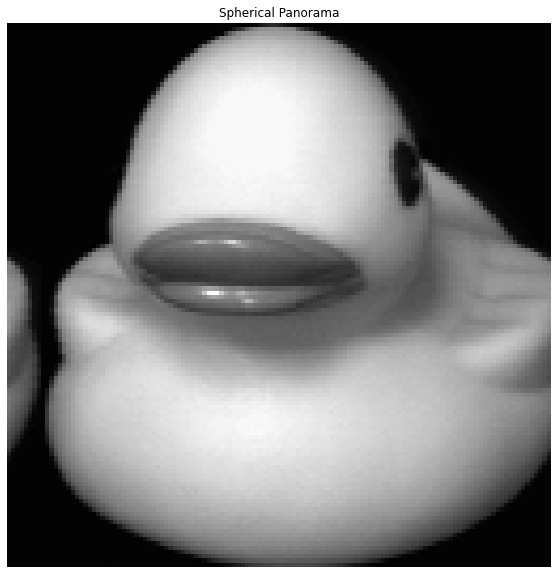

Saved spherical panorama for object 2 to output_spherical_panorama\spherical_panorama_object_2.png.


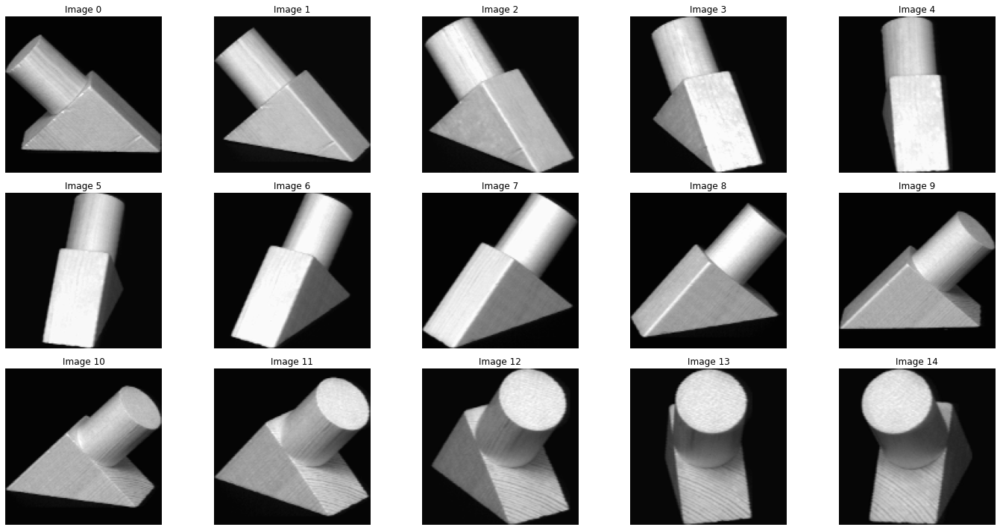

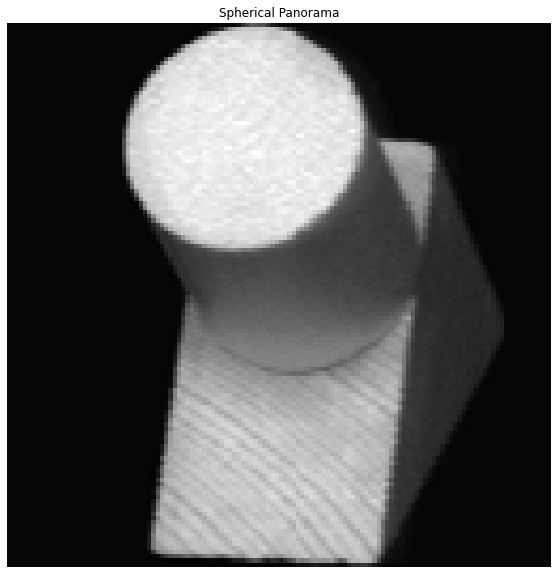

Saved spherical panorama for object 3 to output_spherical_panorama\spherical_panorama_object_3.png.


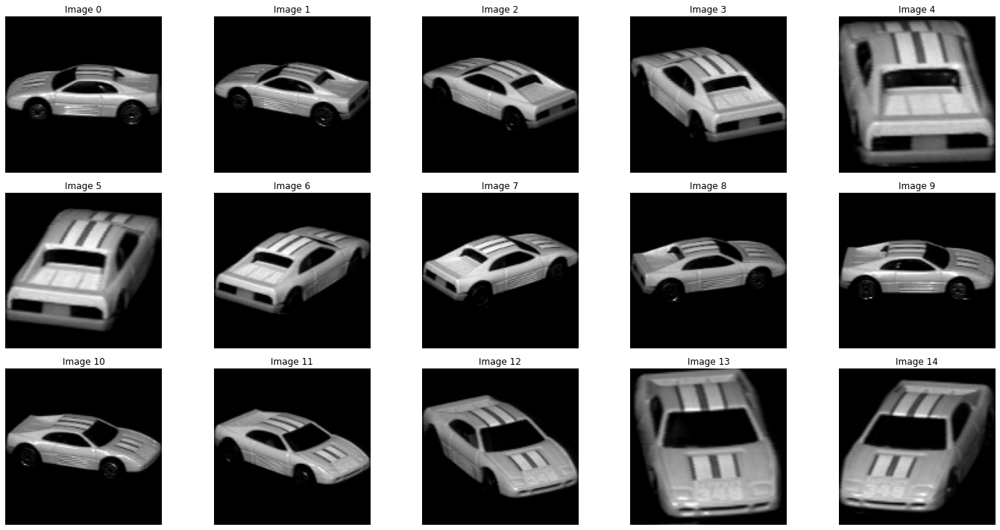

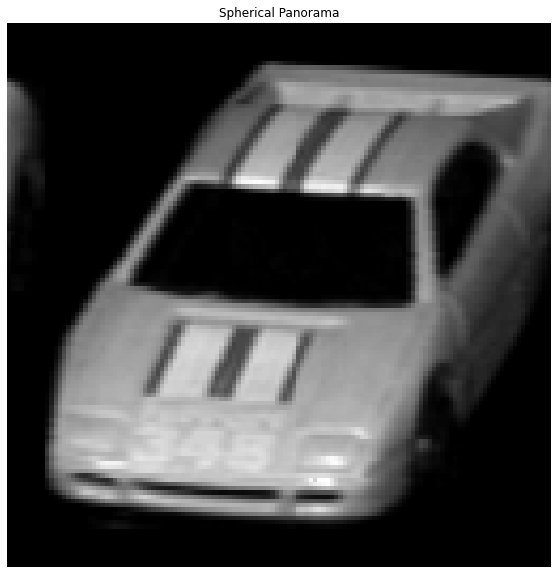

Saved spherical panorama for object 4 to output_spherical_panorama\spherical_panorama_object_4.png.


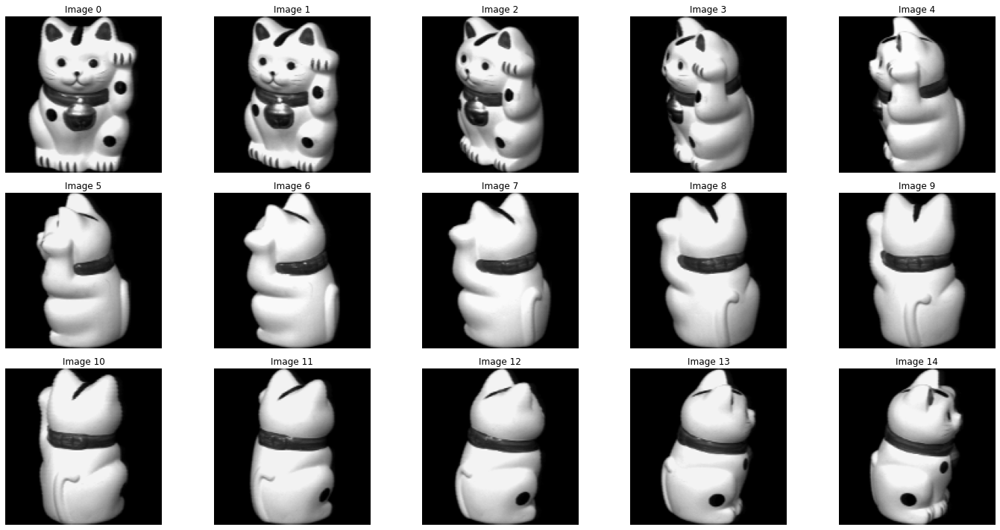

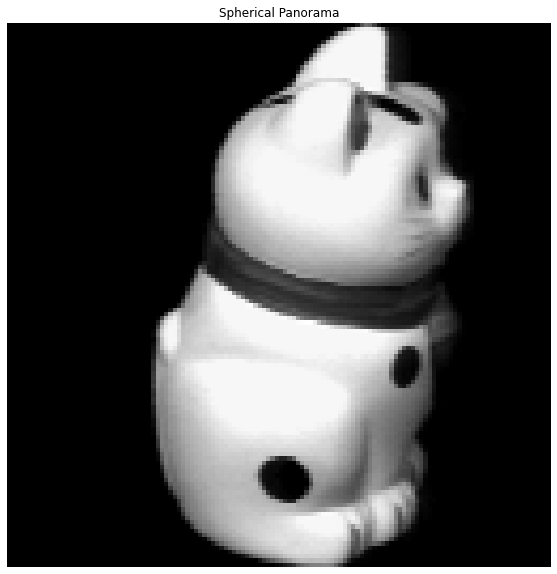

Saved spherical panorama for object 5 to output_spherical_panorama\spherical_panorama_object_5.png.


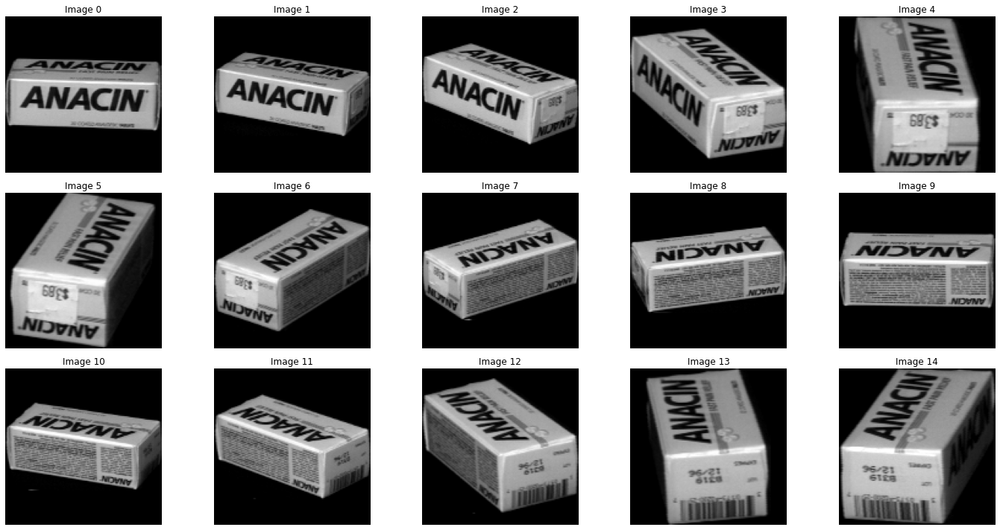

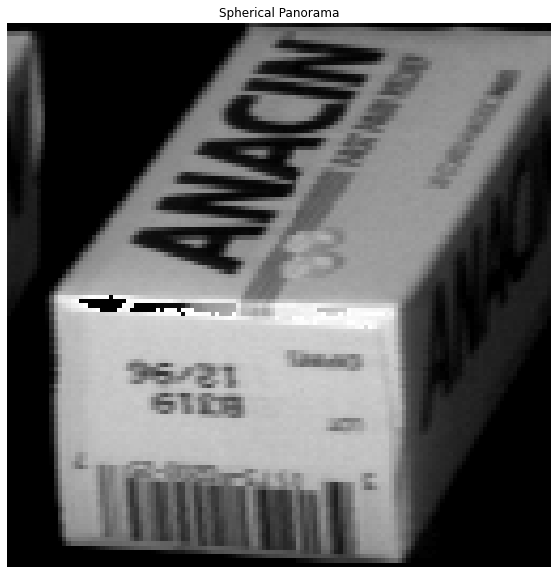

Saved spherical panorama for object 6 to output_spherical_panorama\spherical_panorama_object_6.png.


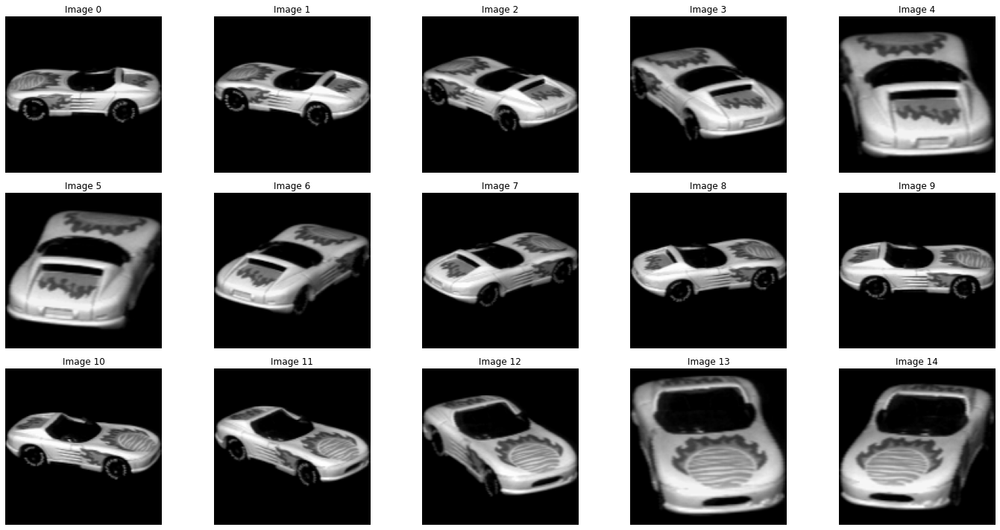

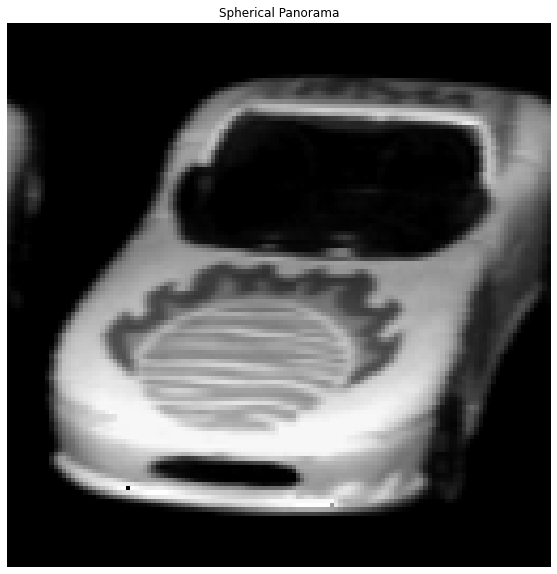

Saved spherical panorama for object 7 to output_spherical_panorama\spherical_panorama_object_7.png.


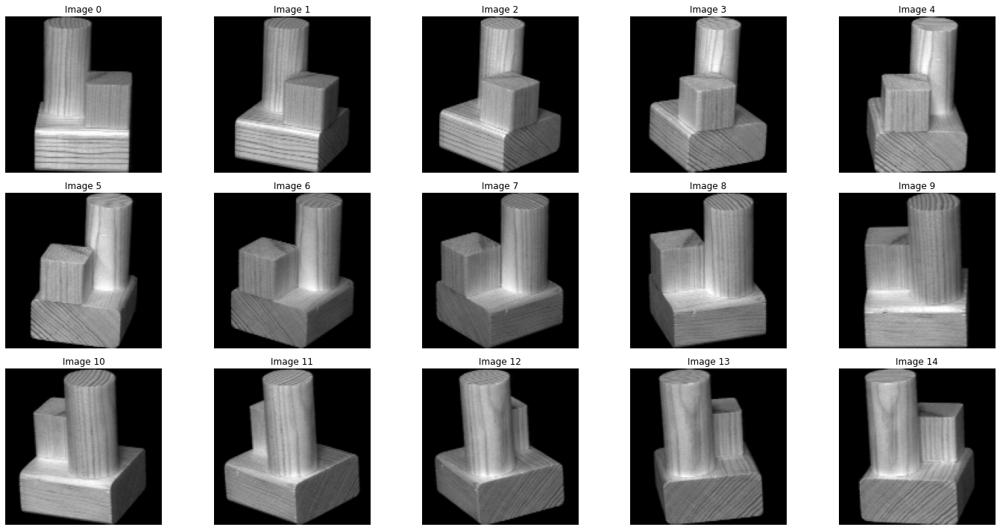

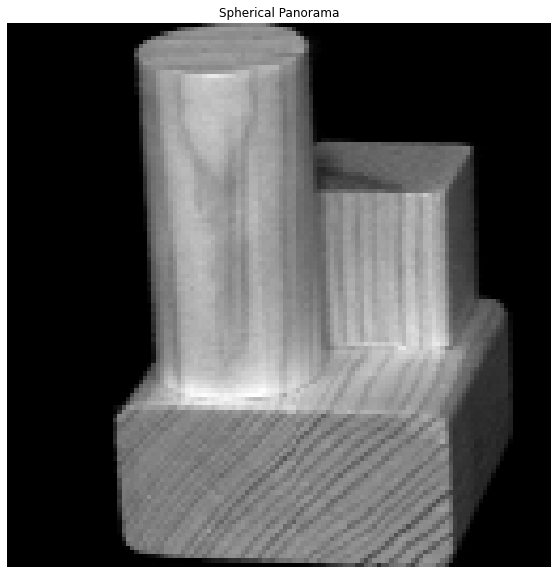

Saved spherical panorama for object 8 to output_spherical_panorama\spherical_panorama_object_8.png.


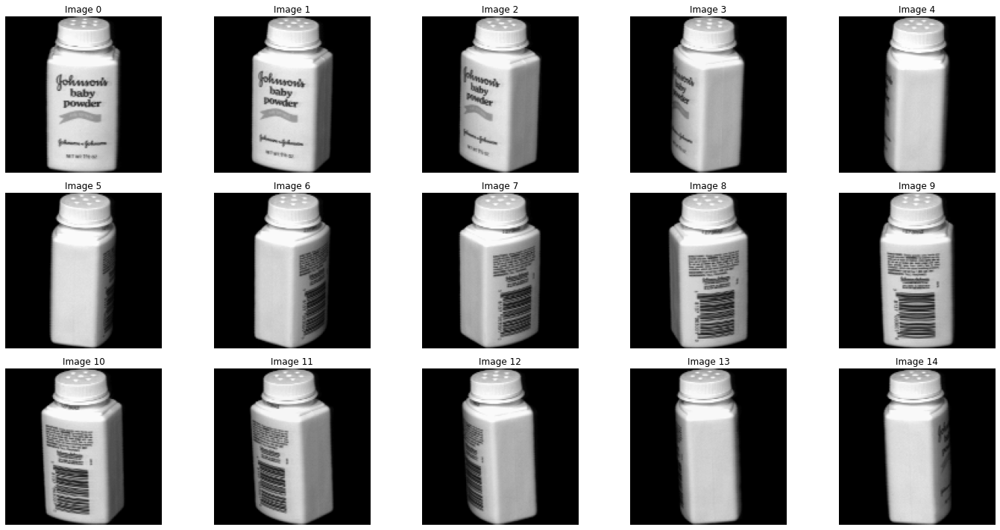

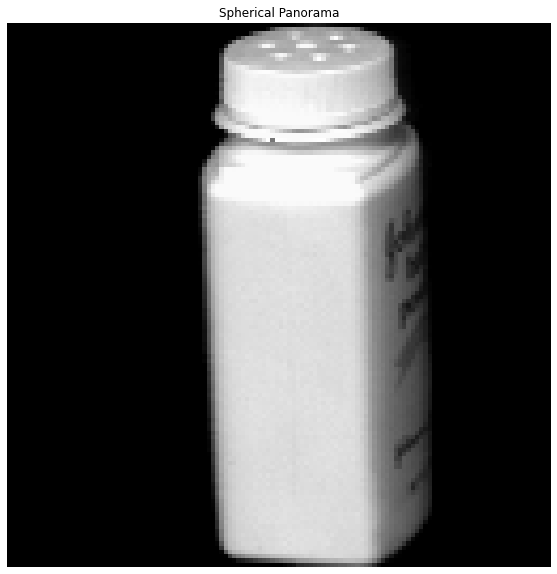

Saved spherical panorama for object 9 to output_spherical_panorama\spherical_panorama_object_9.png.


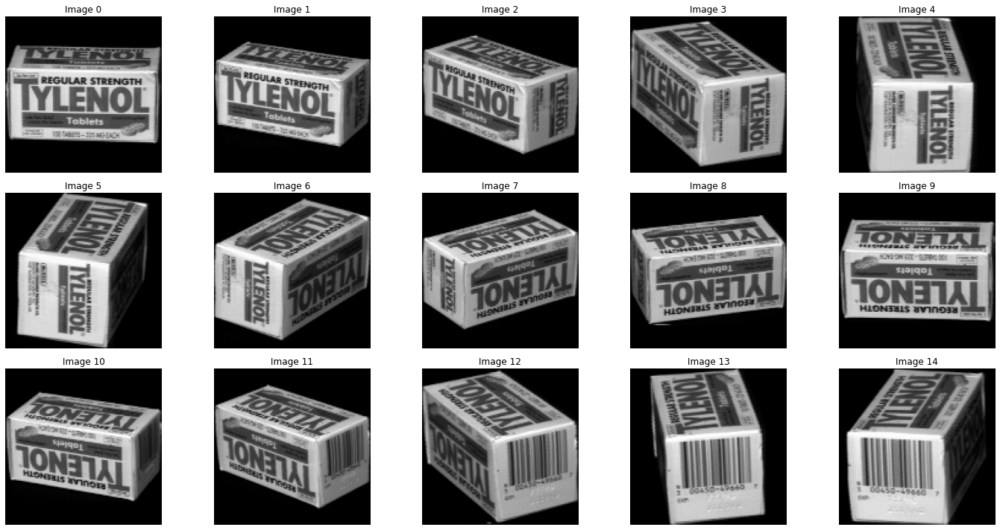

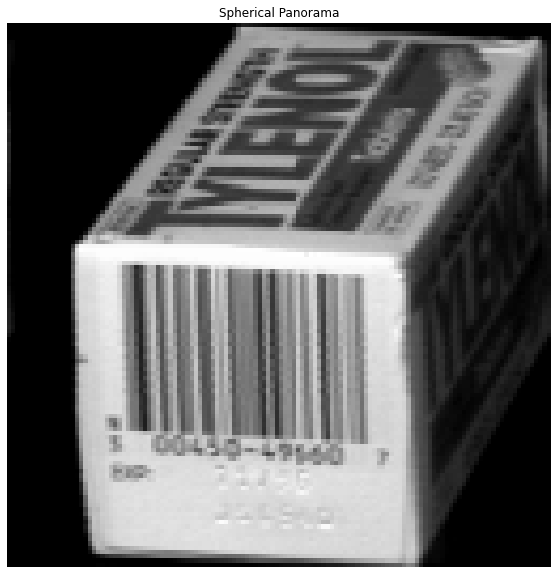

Saved spherical panorama for object 10 to output_spherical_panorama\spherical_panorama_object_10.png.


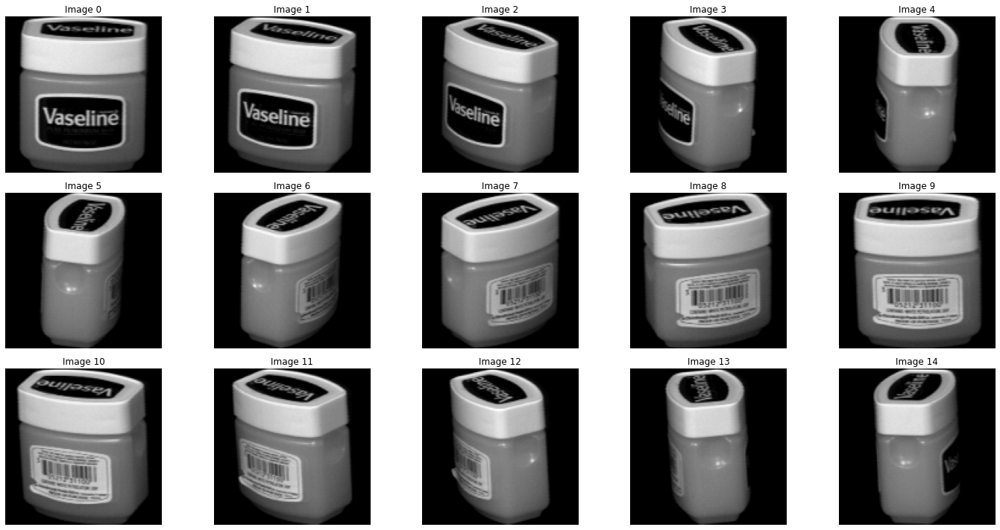

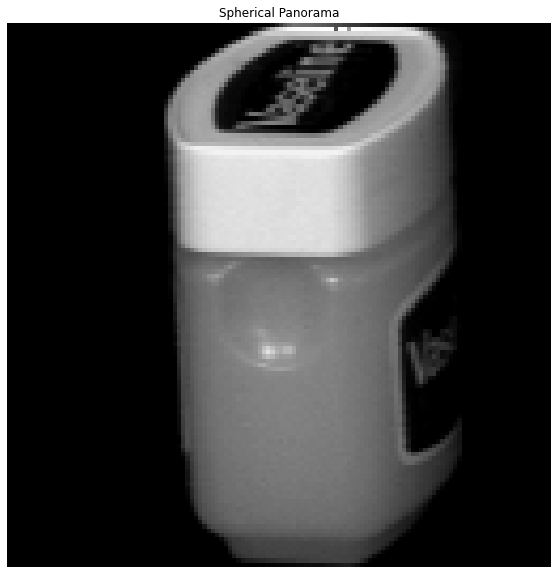

Saved spherical panorama for object 11 to output_spherical_panorama\spherical_panorama_object_11.png.


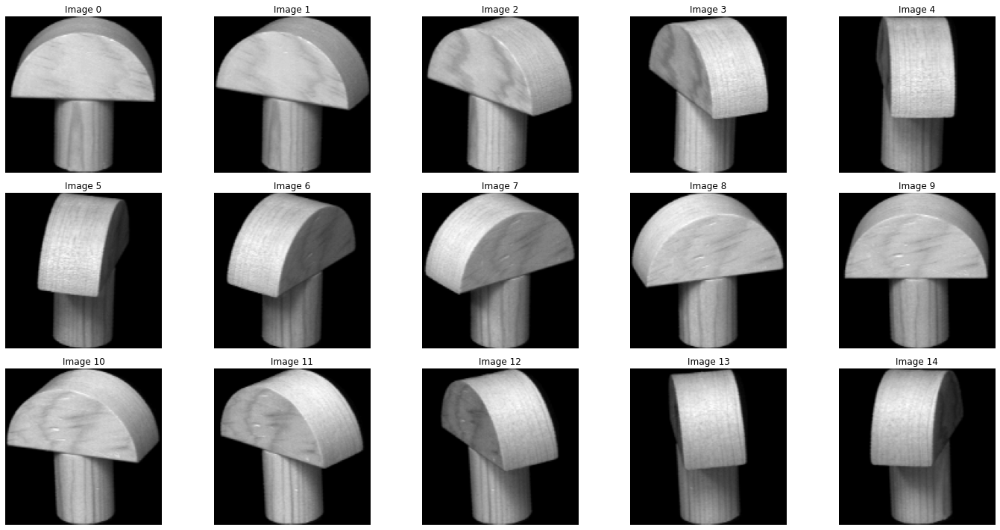

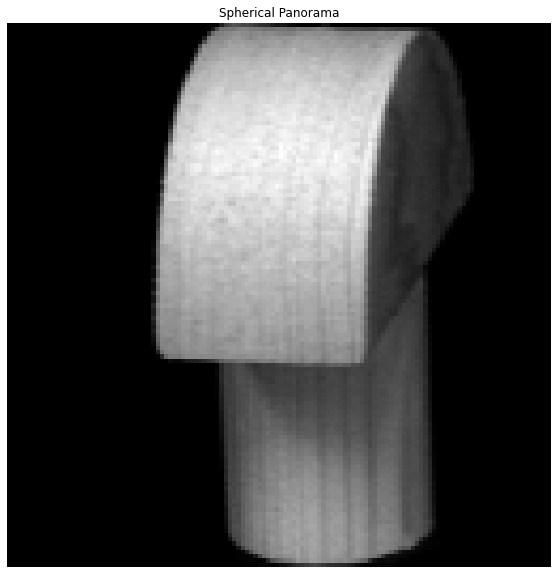

Saved spherical panorama for object 12 to output_spherical_panorama\spherical_panorama_object_12.png.


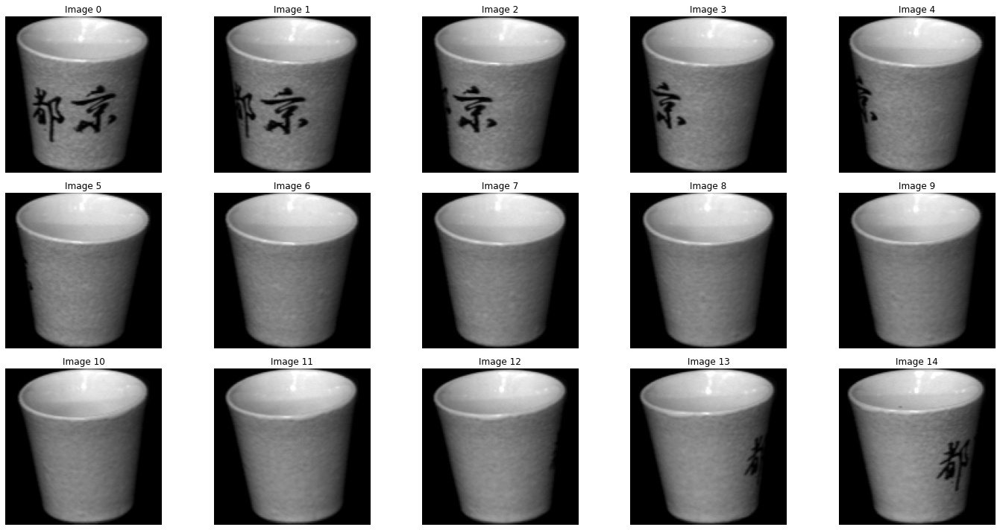

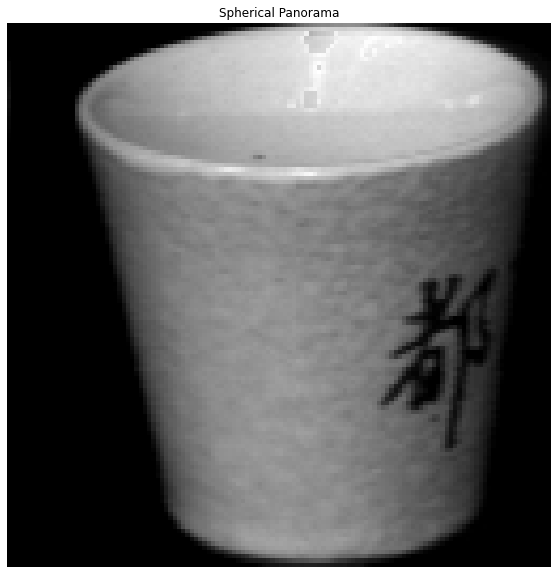

Saved spherical panorama for object 13 to output_spherical_panorama\spherical_panorama_object_13.png.


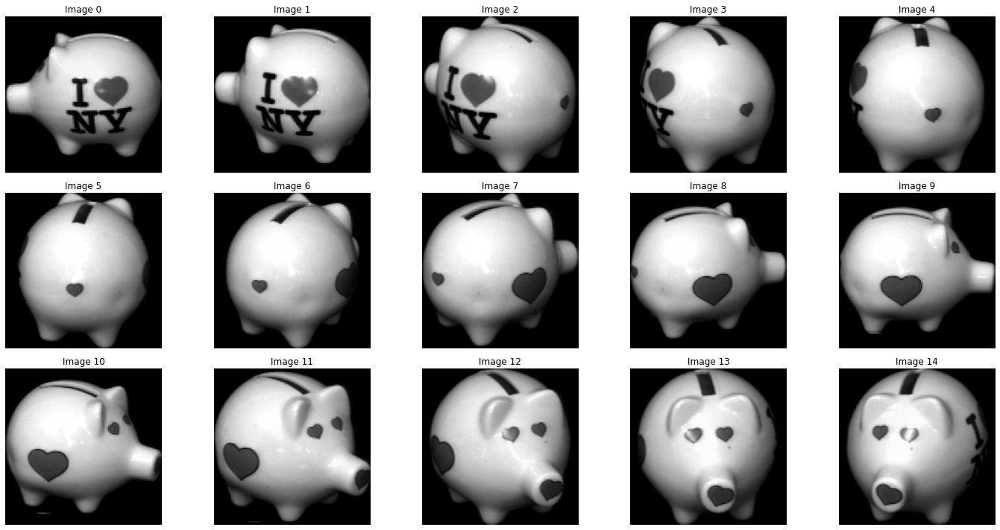

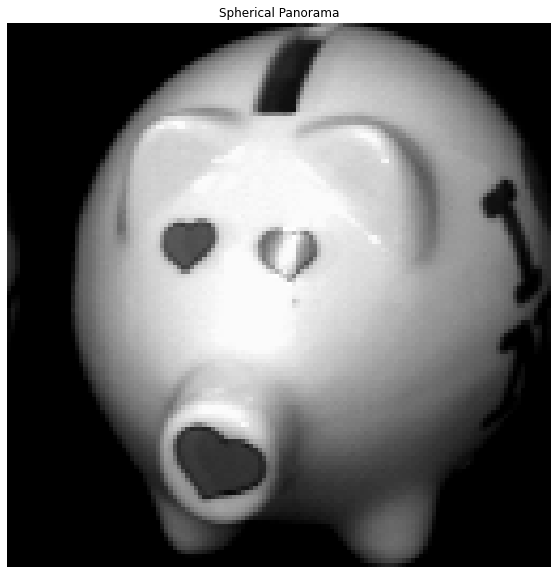

Saved spherical panorama for object 14 to output_spherical_panorama\spherical_panorama_object_14.png.


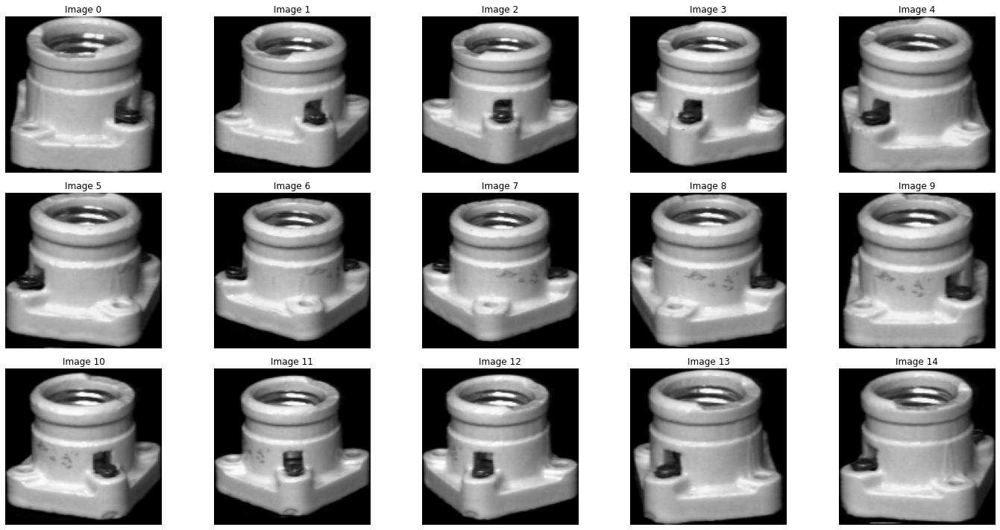

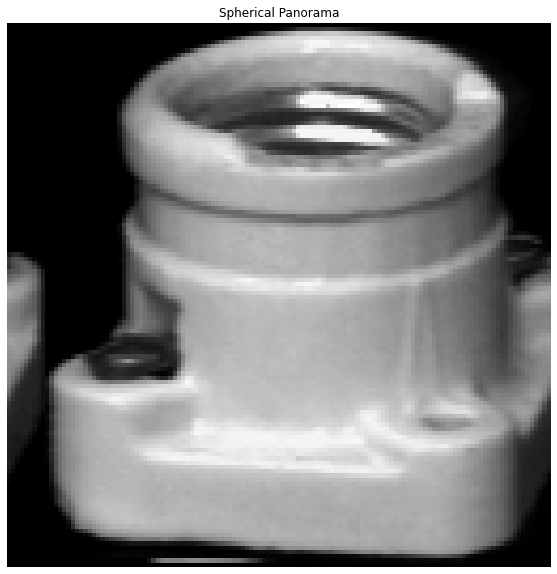

Saved spherical panorama for object 15 to output_spherical_panorama\spherical_panorama_object_15.png.


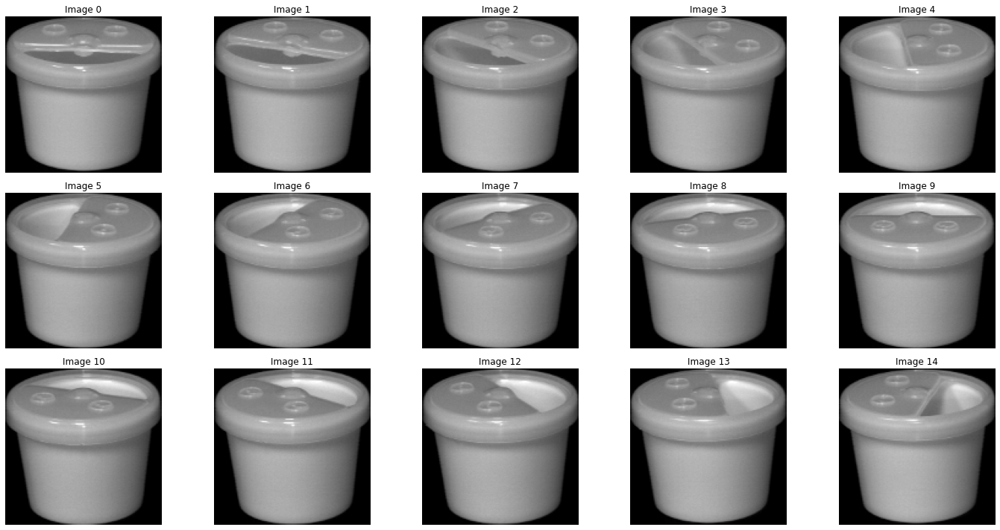

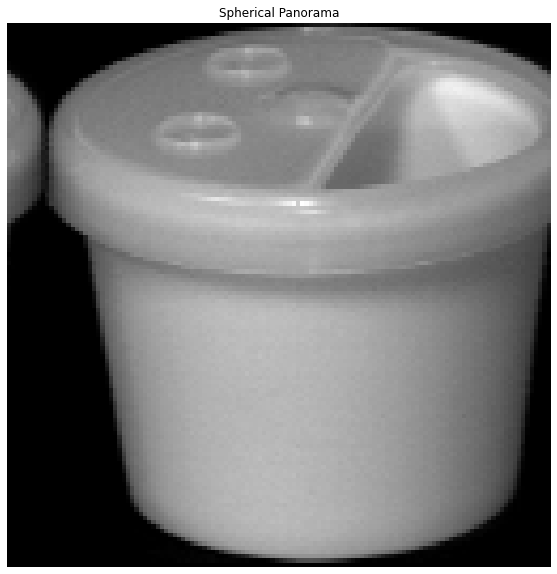

Saved spherical panorama for object 16 to output_spherical_panorama\spherical_panorama_object_16.png.


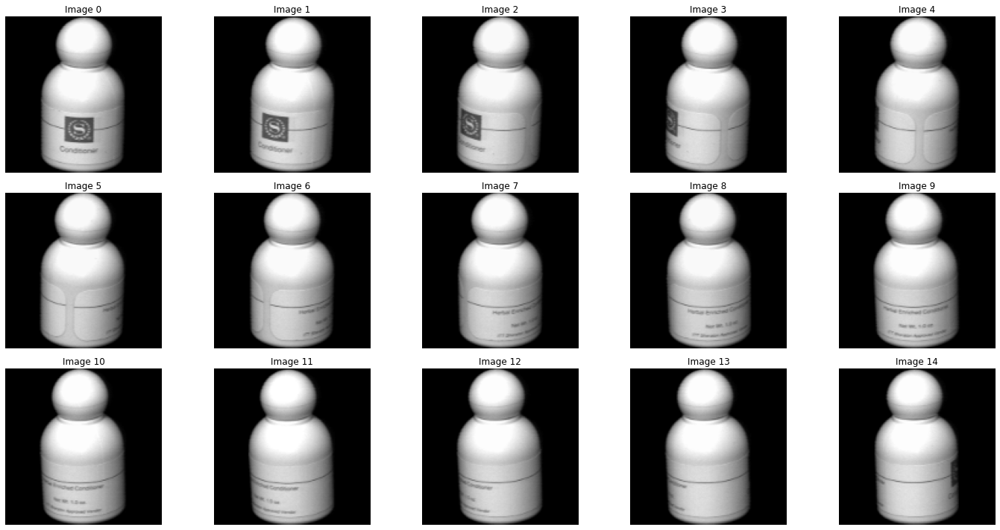

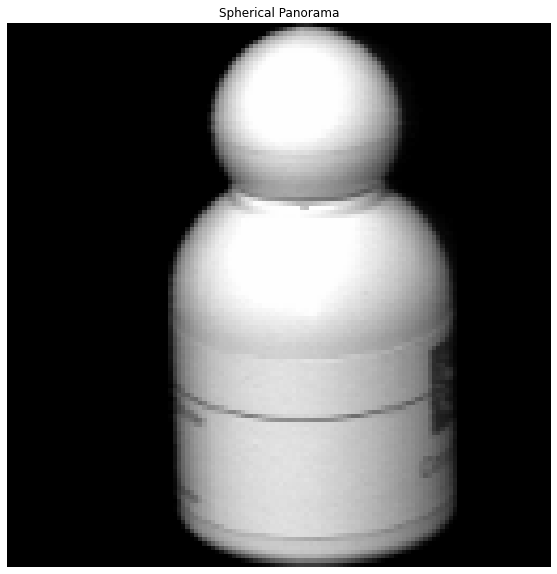

Saved spherical panorama for object 17 to output_spherical_panorama\spherical_panorama_object_17.png.


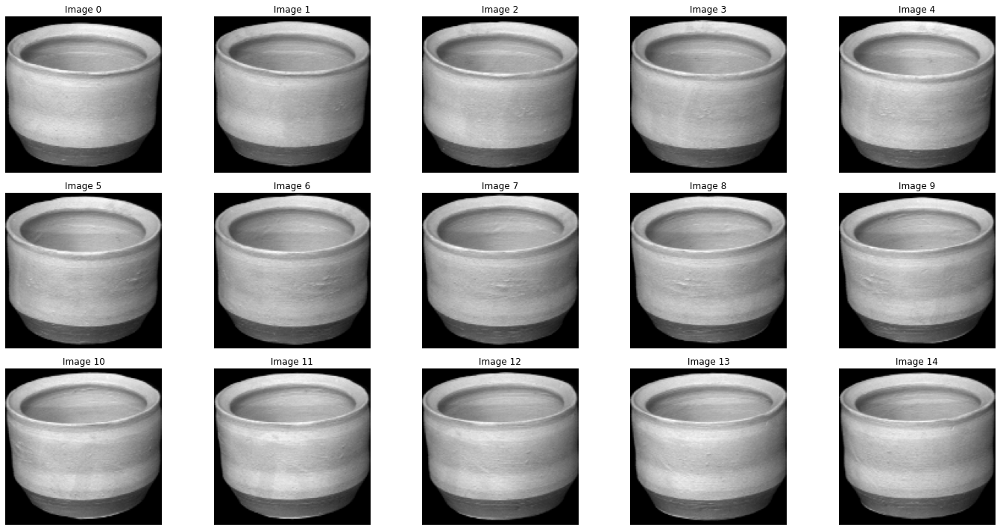

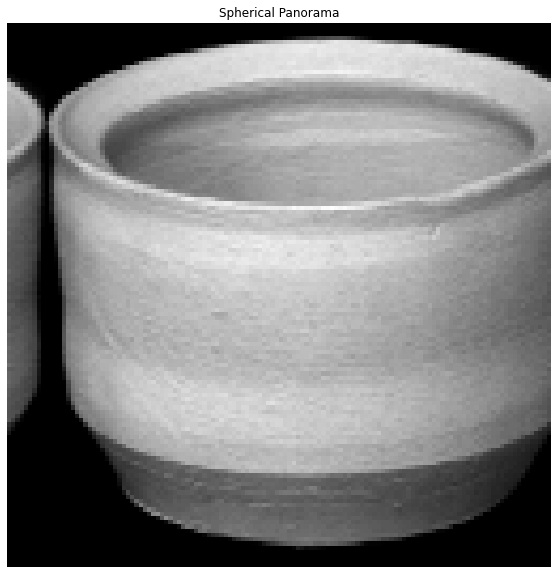

Saved spherical panorama for object 18 to output_spherical_panorama\spherical_panorama_object_18.png.


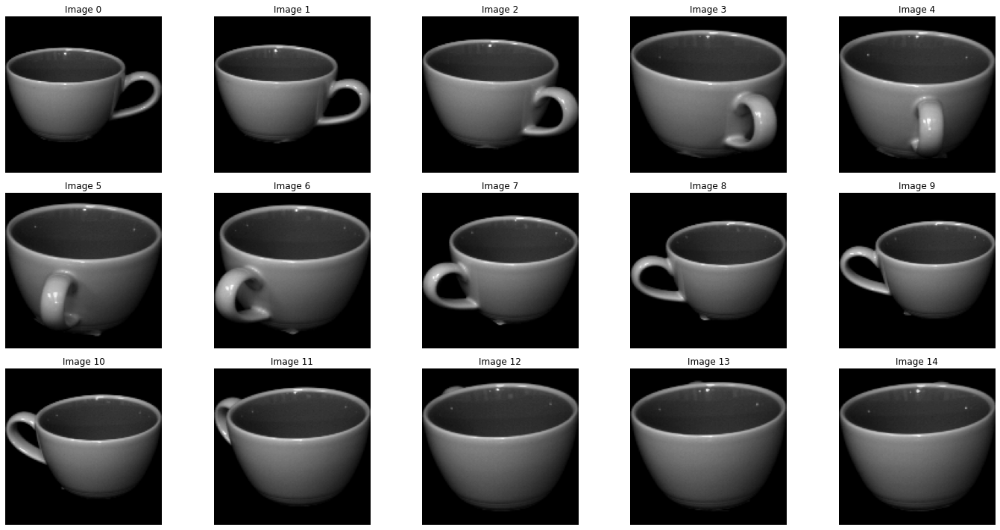

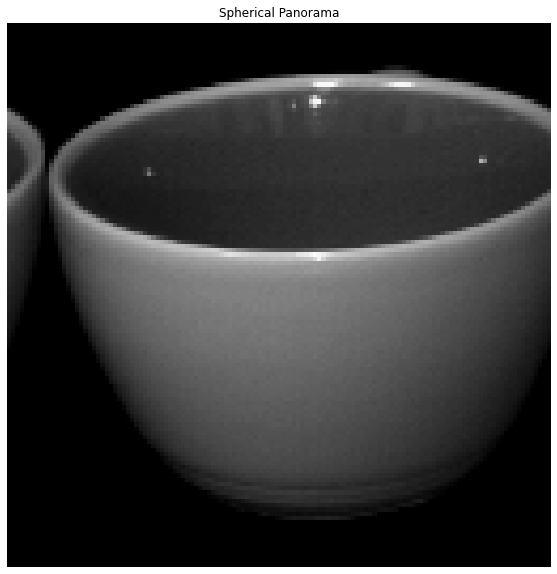

Saved spherical panorama for object 19 to output_spherical_panorama\spherical_panorama_object_19.png.


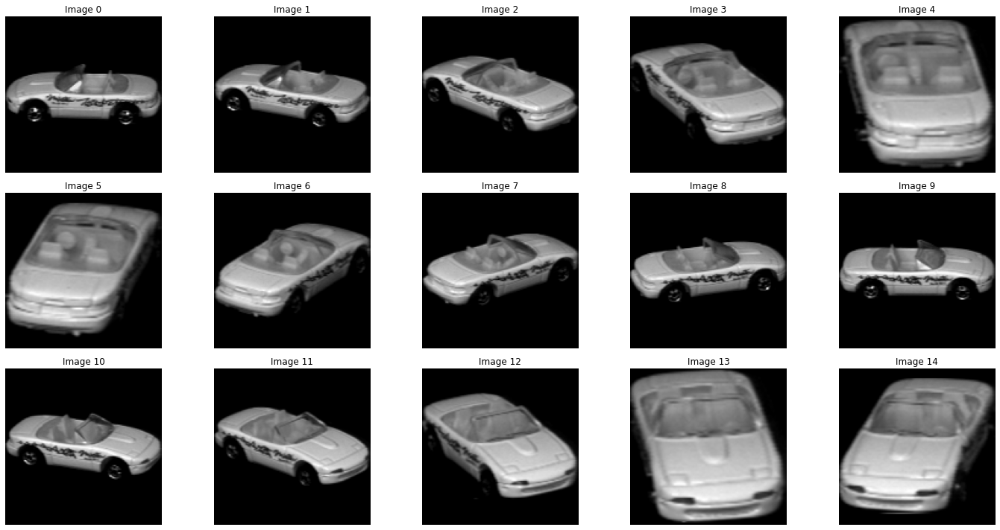

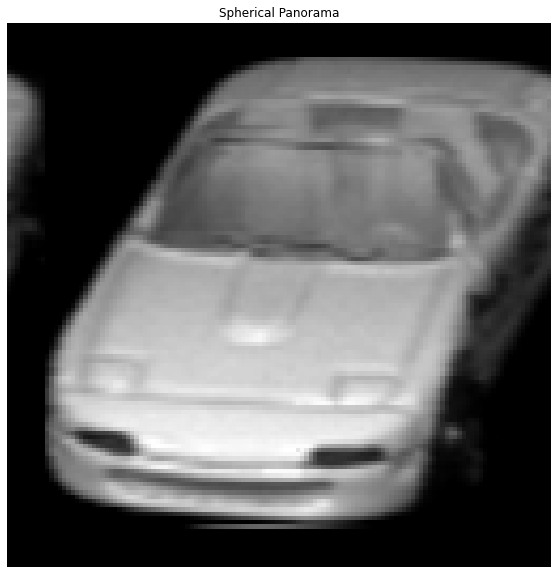

Saved spherical panorama for object 20 to output_spherical_panorama\spherical_panorama_object_20.png.


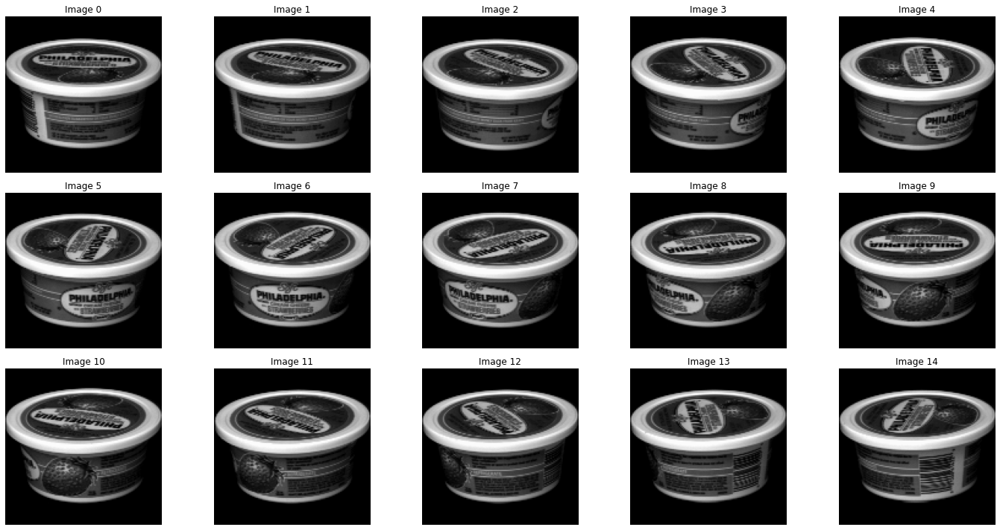

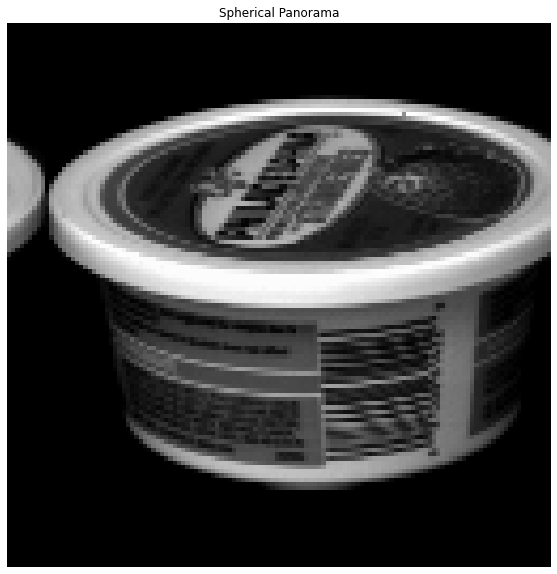

In [60]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def load_images(object_folder, image_list):
    """Load selected images for an object."""
    images = []
    for img_name in image_list:
        img_path = os.path.join(object_folder, img_name)
        img_path = os.path.normpath(img_path)
        if os.path.exists(img_path):
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            if img is not None:
                images.append(img)
    return images

def create_spherical_panorama(images):
    """Create a spherical panorama from a list of images."""
    if len(images) < 2:
        print("At least two images are required for stitching.")
        return None
    
    height, width = images[0].shape
    panorama_width = width
    panorama_height = height
    panorama = np.ones((panorama_height, panorama_width), dtype=np.uint8) * 255

    num_images = len(images)
    angle_step = 360 / num_images

    for i, img in enumerate(images):
        angle = i * angle_step
        angle_rad = np.deg2rad(angle)
        
        # Compute spherical coordinates
        theta = np.linspace(0, 2 * np.pi, panorama_width)
        phi = np.linspace(0, np.pi, panorama_height)
        theta_grid, phi_grid = np.meshgrid(theta, phi)
        
        # Compute the spherical projection
        x = np.floor(((theta_grid + angle_rad) % (2 * np.pi)) * (width / (2 * np.pi))).astype(int)
        y = np.floor(((np.pi - phi_grid) / np.pi) * height).astype(int)

        # Ensure indices are within valid range
        x = np.clip(x, 0, width - 1)
        y = np.clip(y, 0, height - 1)
        
        # Create spherical projection image
        spherical_image = np.zeros((panorama_height, panorama_width), dtype=np.uint8)
        for j in range(panorama_height):
            spherical_image[j, :] = img[y[j], x[j]]

        # Blend images
        mask = (spherical_image < 255).astype(np.uint8)
        panorama = np.where(mask == 1, spherical_image, panorama)
    
    # Flip the panorama vertically
    panorama = np.flipud(panorama)
    
    return panorama

def display_images(images):
    num_images = len(images)
    cols = 5  # Number of columns for the subplot
    rows = (num_images + cols - 1) // cols  # Calculate the number of rows needed

    plt.figure(figsize=(20, 10))
    for i, img in enumerate(images):
        plt.subplot(rows, cols, i + 1)  # Adjust rows and columns based on number of images
        plt.imshow(img, cmap='gray')
        plt.title(f'Image {i}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

def display_panorama(panorama):
    plt.figure(figsize=(15, 10))  # Adjusted size for better visibility in Jupyter Notebook
    plt.imshow(panorama, cmap='gray')
    plt.title('Spherical Panorama')
    plt.axis('off')
    plt.show()

# Directory paths and parameters
dataset_path = r'C:\Users\www\Downloads\archive\coil-20'
output_dir = 'output_spherical_panorama'
os.makedirs(output_dir, exist_ok=True)

# Process each object
for obj_num in range(1, 21):  # Assuming there are 20 objects (1 to 20)
    object_folder = os.path.join(dataset_path, str(obj_num))
    image_list = [f'obj{obj_num}__{i}.png' for i in range(0, 72, 4)]

    # Ensure only 15 images are selected
    image_list = image_list[:15]

    images = load_images(object_folder, image_list)
    spherical_panorama = create_spherical_panorama(images)

    if spherical_panorama is not None:
        output_path = os.path.join(output_dir, f'spherical_panorama_object_{obj_num}.png')
        cv2.imwrite(output_path, spherical_panorama)
        print(f"Saved spherical panorama for object {obj_num} to {output_path}.")

        # Display images
        display_images(images)

        # Display spherical panorama
        display_panorama(spherical_panorama)

    else:
        print(f"Failed to create spherical panorama for object {obj_num}.")
